In [3]:
from PIL import Image
import os
import matplotlib.pyplot as plt
import numpy as np
import cv2
from sklearn.feature_extraction.image import extract_patches_2d
from sklearn.feature_extraction.image import reconstruct_from_patches_2d
os.getcwd()

'/home/otto.tavares/public/iltbi/rxp2p-cycle/notebooks'

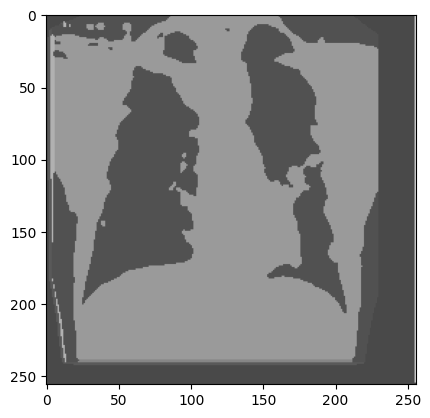

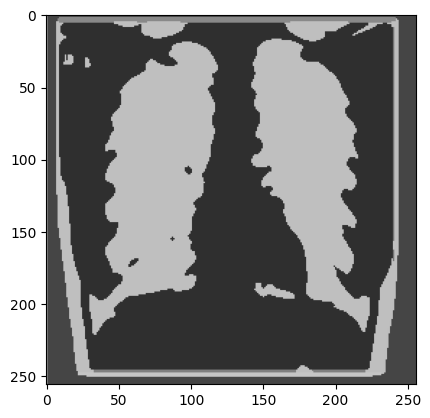

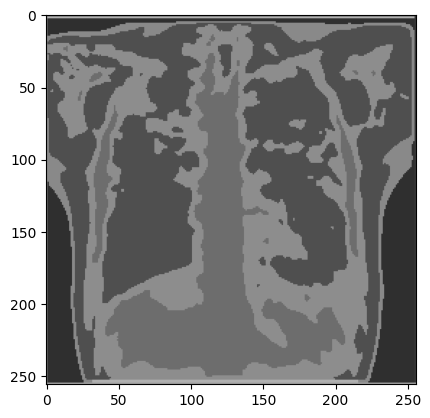

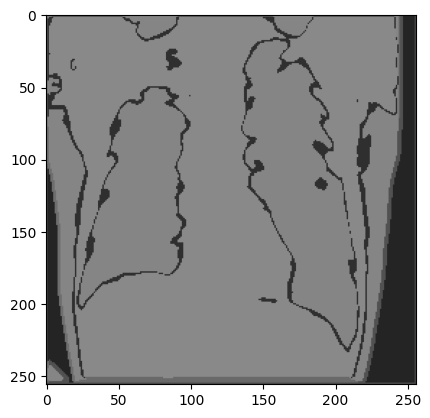

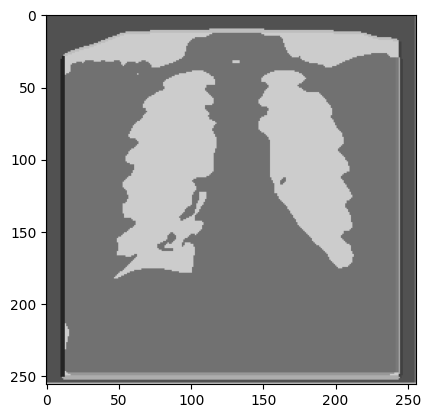

...

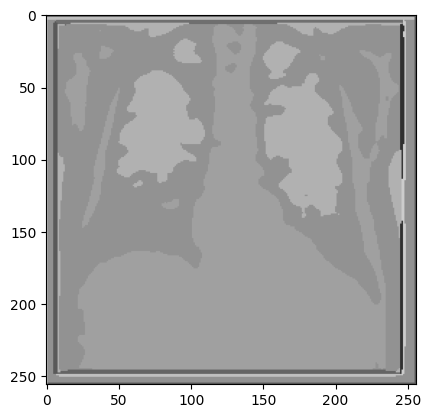

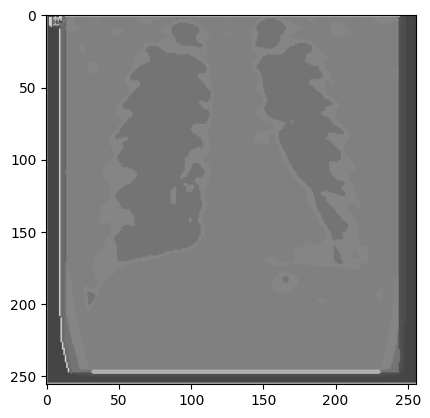

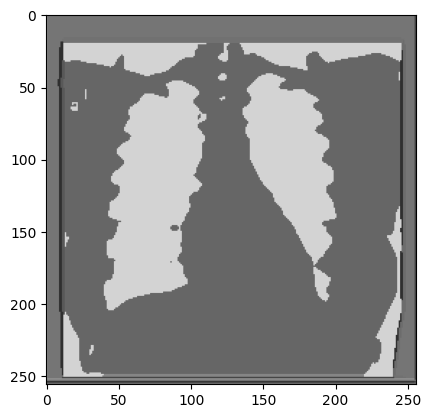

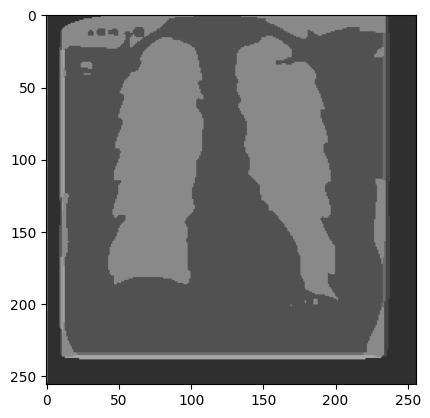

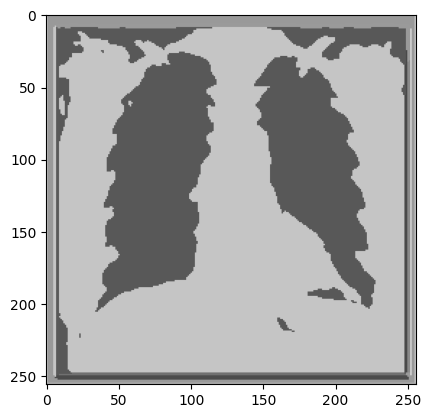

In [32]:
path = '/home/otto.tavares/public/segmentation_wnet/results_masks/c_manaus/'
imgs = os.listdir(path)
for im_nm in imgs:
    im_path = '/home/otto.tavares/public/segmentation_wnet/results_masks/Manaus/%s' % (im_nm)
    im = Image.open(im_path).convert('L')
    plt.figure()
    plt.imshow(im, cmap='gray', vmin=0, vmax=255)
    plt.show()
    plt.close()

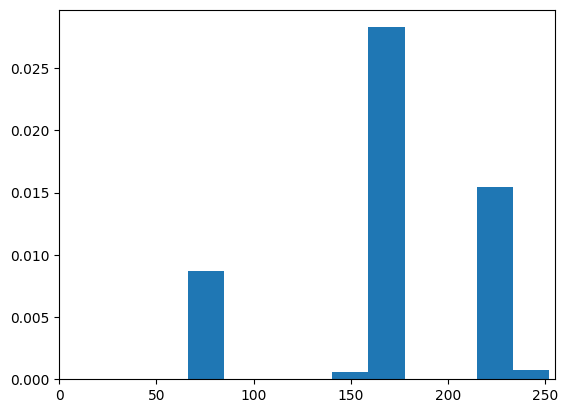

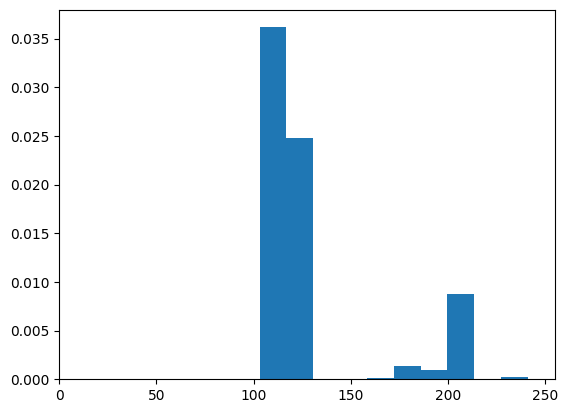

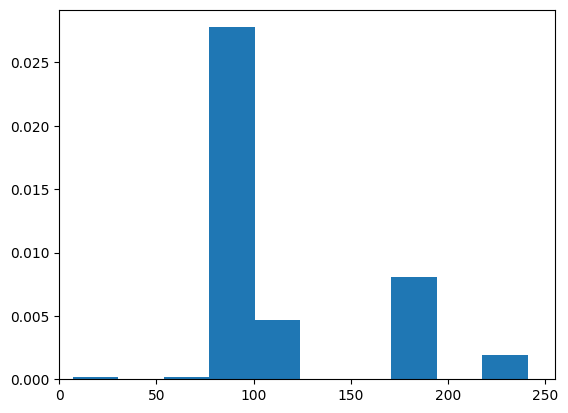

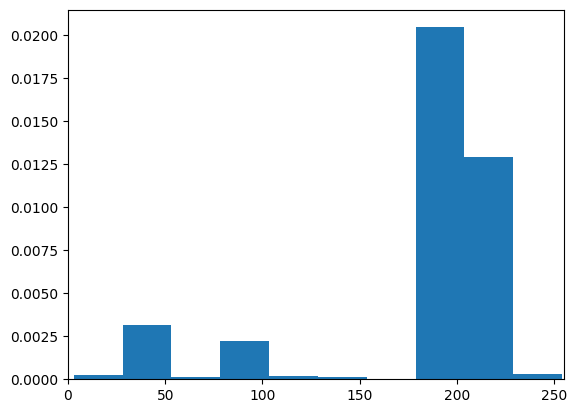

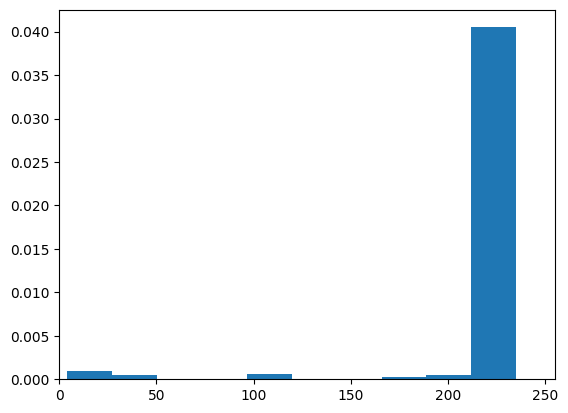

...

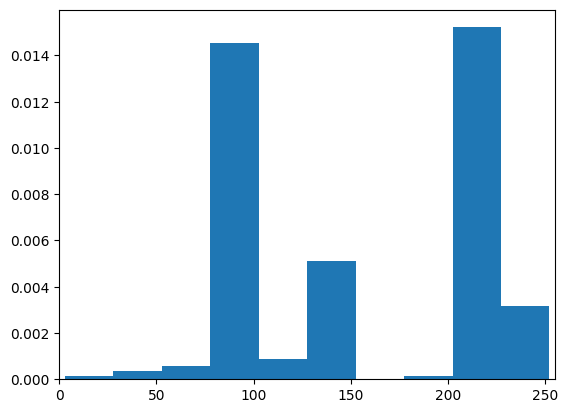

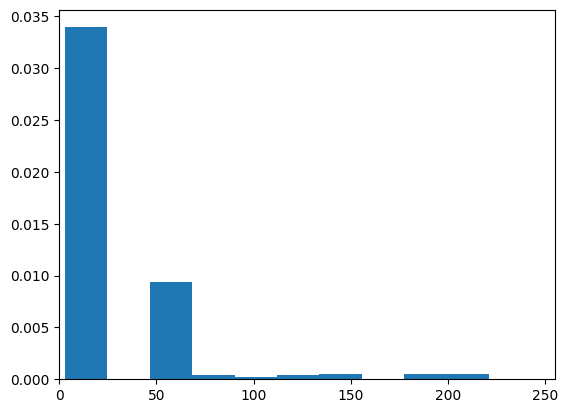

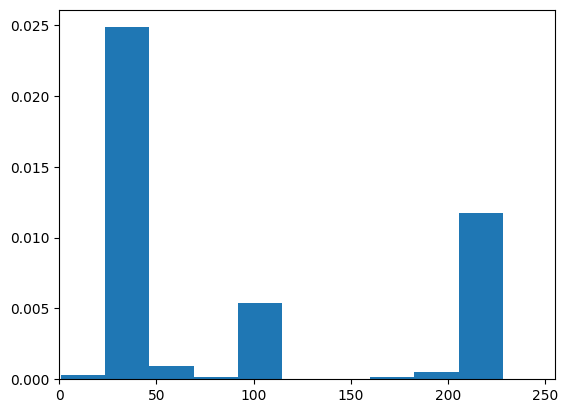

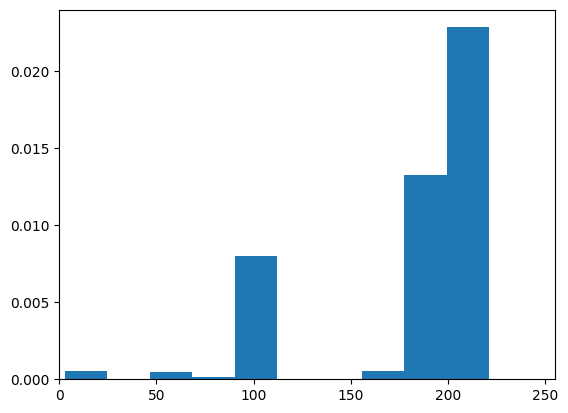

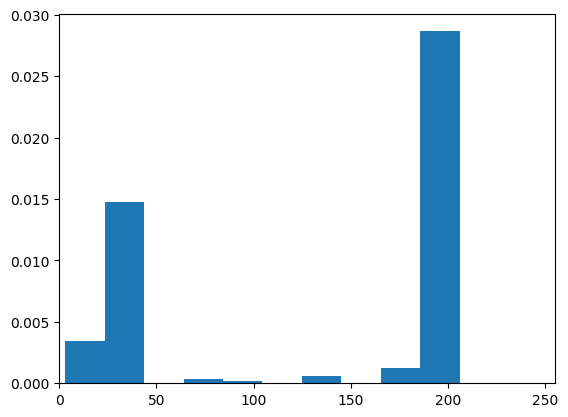

In [33]:
path = '/home/otto.tavares/public/segmentation_wnet/results_masks/Manaus/'
imgs = os.listdir(path)
for im_nm in imgs:
    im_path = '/home/otto.tavares/public/segmentation_wnet/results_masks/Manaus/%s' % (im_nm)
    im = np.asarray(Image.open(im_path))
    im = im[:,:,0]
    im = np.reshape(im,[im.shape[0]*im.shape[1]], order='C')
    histogram, bin_edges = np.histogram(im, bins = 256, range=(0, 1))
    plt.figure()
    plt.hist(im, density=True)
    plt.xlim( 0, 255 )
    plt.show()
    #plt.figure()
    #plt.title("Grayscale Histogram")
    #plt.xlabel("grayscale value")
    #plt.ylabel("pixel count")
    #plt.xlim([0.0, 1.0])  # <- named arguments do not work here
    #plt.plot(bin_edges[0:-1], histogram)
plt.close()

In [34]:
dic_masks = pd.read_csv('dicionario_masks_manaus.csv', sep = ";")[['project_id','binary_limiar', 'binary_limiar_aux']]
dic_masks.sort_values('project_id')

,project_id,binary_limiar,binary_limiar_aux
0,manau_029C6688D833D416571E9E7751E2351CBEF8A948...,NaN,1.0
1,manau_04BD6EC3C4775165A4C6431D1F07705BD46ACF67...,0.0,NaN
2,manau_058C91CC0DBC3BC2C6041181039A5464476DB983...,0.0,NaN
3,manau_0809B9291C1DE0E6BD420CCF423A0EF54B143D43...,0.0,NaN
4,manau_08379473CB482ED87E0427390C525A9CFCAC29D4...,NaN,NaN
...,...,...,...
183,manau_FBE5CE51D7B0F046C5816A437910BBB39FB9FD07...,1.0,NaN
184,manau_FC4EC4C14E09320BB3E1207DA3666B4B74791A2E...,NaN,0.0
185,manau_FD76E1E8EC3C283919E0FFF954049F91F30F30CB...,1.0,NaN
186,manau_FE0742AF3063CED1BB853EA393F6B7FF6F8ABD70...,1.0,NaN


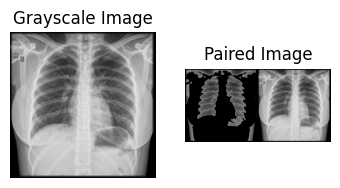

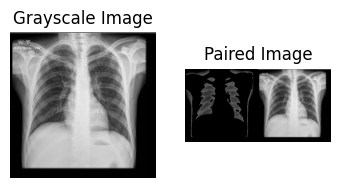

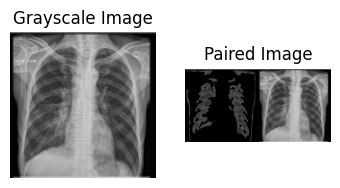

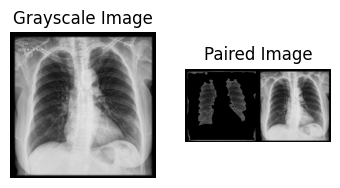

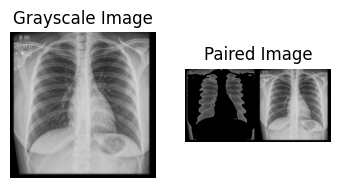

...

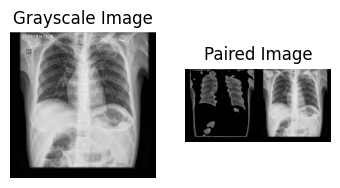

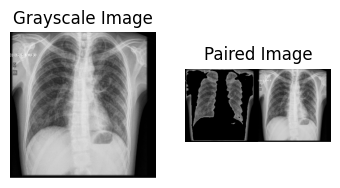

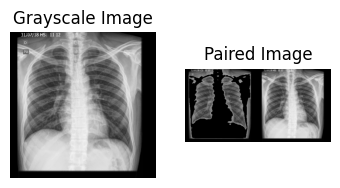

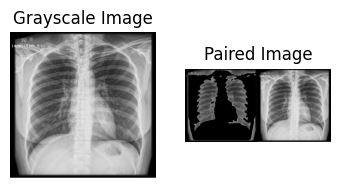

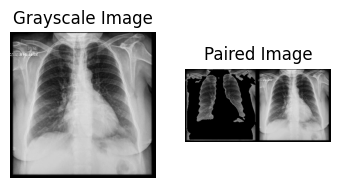

In [50]:
import pandas as pd
dic_masks = pd.read_csv('dicionario_masks_manaus.csv', sep = ";")[['project_id','binary_limiar', 'binary_limiar_aux']]
dic_masks = dic_masks.loc[pd.notnull(dic_masks.binary_limiar)]
dic_masks_1 = dic_masks.loc[dic_masks['binary_limiar'] == 1]
dic_masks_0 = dic_masks.loc[dic_masks['binary_limiar'] == 0]


for nm in dic_masks_0['project_id']:
    path_img = '/home/brics/public/brics_data/Manaus/manaus/raw/images/%s' % (nm.replace('mask_', ''))
    path_mask = '/home/otto.tavares/public/segmentation_wnet/results_masks/Manaus/mask_%s' % (nm)
    path_pair = '/home/otto.tavares/public/iltbi/train/images/Manaus_AB/%s' % (nm.replace('mask_', ''))
    mask = cv2.cvtColor(cv2.imread(path_mask), cv2.COLOR_BGR2GRAY)
    
    ret,thresh_mask = cv2.threshold(mask,122,255,cv2.THRESH_BINARY_INV + 
                                            cv2.THRESH_OTSU)

    dim = (len(thresh_mask),len(thresh_mask))
    im = cv2.cvtColor(cv2.resize(cv2.imread(path_img), dim, interpolation=cv2.INTER_CUBIC),cv2.COLOR_BGR2GRAY)
    mask_par = (thresh_mask/255) * im
    im_pair = np.concatenate([mask_par, im], 1)
    plt.subplot(131),plt.imshow(im,cmap = 'gray'),plt.title('Grayscale Image'),plt.axis('off')
    plt.subplot(132),plt.imshow(im_pair,cmap = 'gray'),plt.title('Paired Image'),plt.axis('off')
    plt.show()
    cv2.imwrite(path_pair, im_pair)

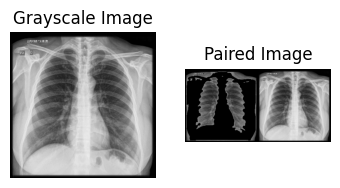

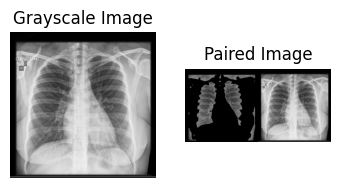

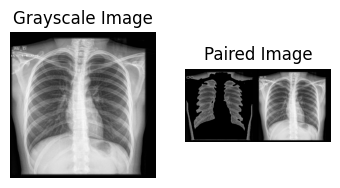

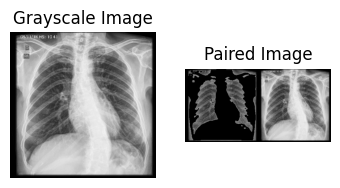

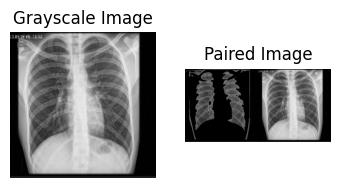

...

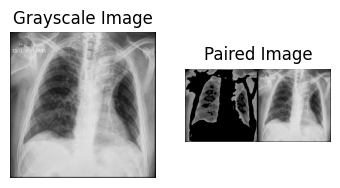

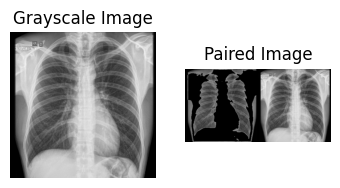

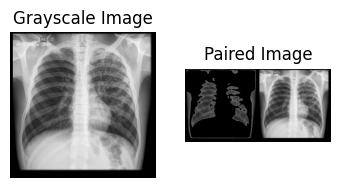

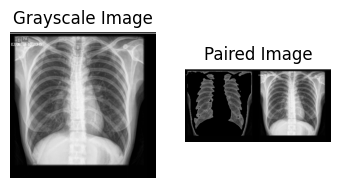

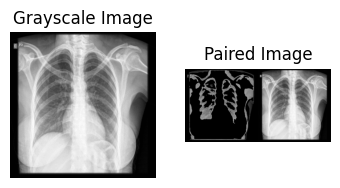

In [49]:
import pandas as pd
dic_masks = pd.read_csv('dicionario_masks_manaus.csv', sep = ";")[['project_id','binary_limiar', 'binary_limiar_aux']]
dic_masks = dic_masks.loc[dic_masks['binary_limiar'] != ' ']
dic_masks_1 = dic_masks.loc[dic_masks['binary_limiar'] == 1]
dic_masks_0 = dic_masks.loc[dic_masks['binary_limiar'] == 0]


for nm in np.sort(dic_masks_1['project_id']):
    path_img = '/home/brics/public/brics_data/Manaus/manaus/raw/images/%s' % (nm.replace('mask_', ''))
    path_mask = '/home/otto.tavares/public/segmentation_wnet/results_masks/Manaus/mask_%s' % (nm)
    path_pair = '/home/otto.tavares/public/iltbi/train/images/Manaus_AB/%s' % (nm.replace('mask_', ''))
    mask = cv2.cvtColor(cv2.imread(path_mask), cv2.COLOR_BGR2GRAY)
    
    ret,thresh_mask = cv2.threshold(mask,122,255,cv2.THRESH_BINARY + 
                                            cv2.THRESH_OTSU)
    dim = (len(thresh_mask),len(thresh_mask))
    im = cv2.cvtColor(cv2.resize(cv2.imread(path_img), dim, interpolation=cv2.INTER_CUBIC),cv2.COLOR_BGR2GRAY)
    mask_par = (thresh_mask/255) * im
    im_pair = np.concatenate([mask_par, im], 1)
    plt.subplot(131),plt.imshow(im,cmap = 'gray'),plt.title('Grayscale Image'),plt.axis('off')
    plt.subplot(132),plt.imshow(im_pair,cmap = 'gray'),plt.title('Paired Image'),plt.axis('off')
    plt.show()
    cv2.imwrite(path_pair, im_pair)

mask_manau_029C6688D833D416571E9E7751E2351CBEF8A9486DF5D5CC5090B4FE49194B01_029C66.png


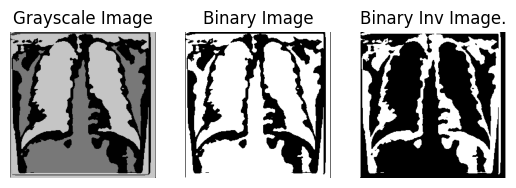

mask_manau_04BD6EC3C4775165A4C6431D1F07705BD46ACF670E3D95BF67E2C59267CAEBA4_04BD6E.png


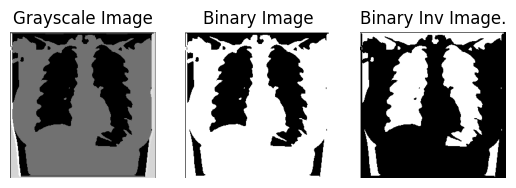

mask_manau_058C91CC0DBC3BC2C6041181039A5464476DB983F07BBE457CE4583AB2E4B4D3_058C91.png


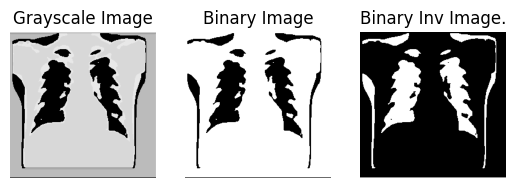

mask_manau_0809B9291C1DE0E6BD420CCF423A0EF54B143D43256CC344A0BAF7B52467E906_0809B9.png


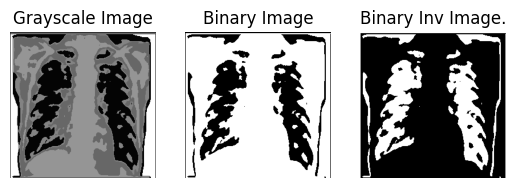

mask_manau_08379473CB482ED87E0427390C525A9CFCAC29D4C738A2A0D9B4514340B3A7B5_083794.png


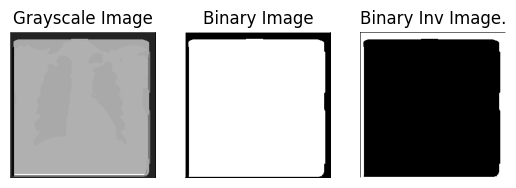

mask_manau_08F3CAFDD2EEAE657E0D29AF1A1C6BB5F255B92EEC8AC30C38E66C968BDDC162_08F3CA.png


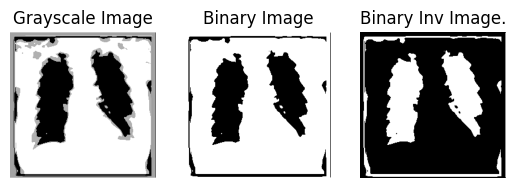

mask_manau_09E55C009FC7BCF1271A6824934275097CE125412D214FCD691E2EAA466E2505_09E55C.png


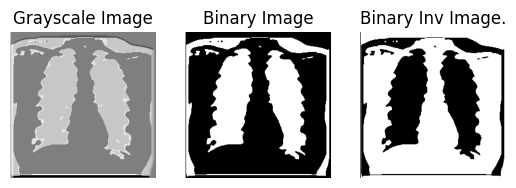

mask_manau_09EA52A3B528712C5BDA5AB02C8209F394E47F8D2E51EAAD65A23EA987FBB01A_09EA52.png


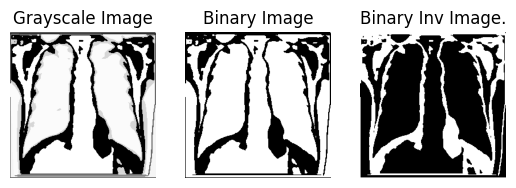

mask_manau_0C094165ABE2E79FD70581B89E5BA785B14ADA88E6AAE9563DF6E382FEE3CE70_0C0941.png


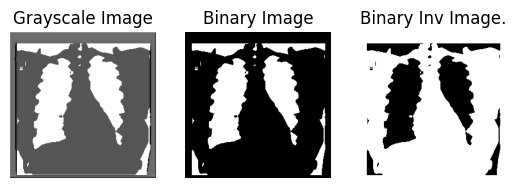

mask_manau_0D9233D27B3CD50B1F3B83D801EFC00D5C122B4BABD89D0182C5AE75C900863D_0D9233.png


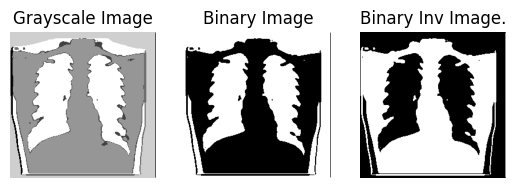

mask_manau_0DED0A5CB7378FD54D4407D3B822C5CB783E146C67F2C080E7AE7C48431E7F87_0DED0A.png


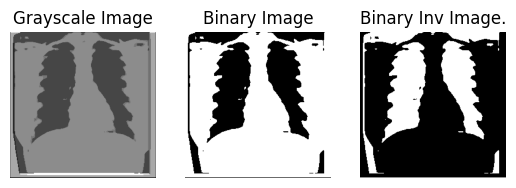

mask_manau_0E9D5B913A9E1893B4013A4E8A832F30E2735BED0ED5058DFF707F6D56E99FE4_0E9D5B.png


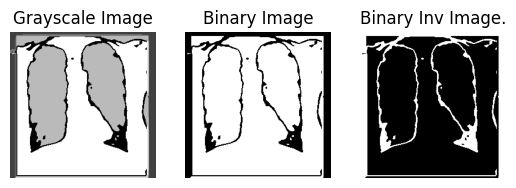

mask_manau_0F30E278FDD8DC52822849D049F5B34464ADEC2648BABC6252FC809CDF0D5DBE_0F30E2.png


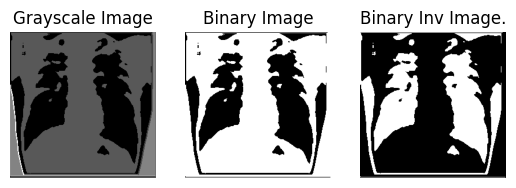

mask_manau_12409688A77A8C4BF3D55AD8AE0B1D772BD16B180BAFC6D8D1A20FF208B61593_124096.png


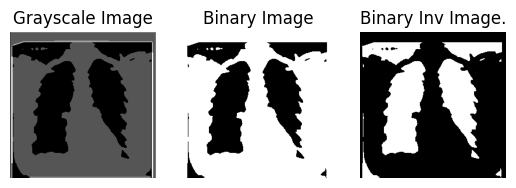

mask_manau_13D1386058D5C3E32937BA60B008481F4F177A66A7A13ACC0782D580DD41AAF1_13D138.png


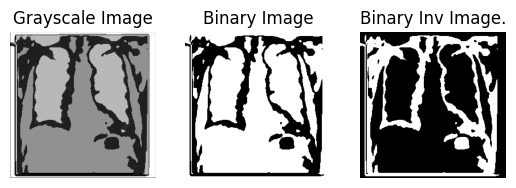

mask_manau_1513C3EEBE3E8F8FF7A9782B2AE8E4A486E44A73F4CAF5B35A0C5BE44BC16C58_1513C3.png


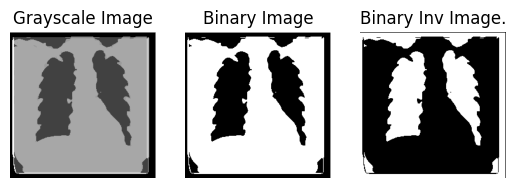

mask_manau_16F6770DA270377907BE2661C20948DAAFCA3DA86513967C40DF05CC49BBCC01_16F677.png


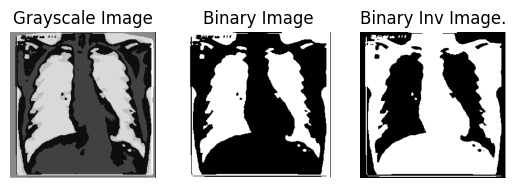

mask_manau_18C0CAA8A095ABDE3C0E659FE038A6737C40161EF66AE9DD776B3D07D56131F0_18C0CA.png


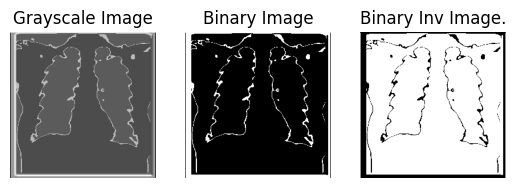

mask_manau_1B318D754F43F137F49ADA9090986B0B9CE35B8C4EE2DDF9FCDA370FCCC2EB27_1B318D.png


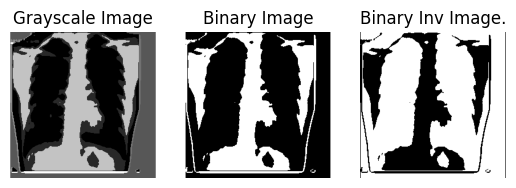

mask_manau_1EADFBB1810327FF1AB5DF29D29F6AF249020F36D3D9AF73268E6C838362B556_1EADFB.png


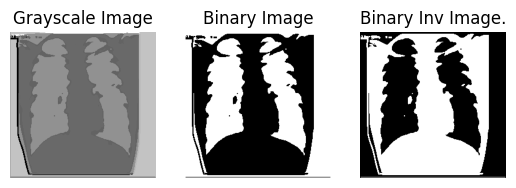

mask_manau_202CA480AD77B5911AC9E5D94ADDBB63FEFC43BD5E394D359823D814AB4FB24D_202CA4.png


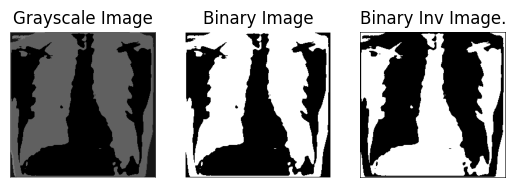

mask_manau_20652C99F32242E39C0CC170E925EC8152ABF7C6ECBDAF40757983E4EC6D6A05_20652C.png


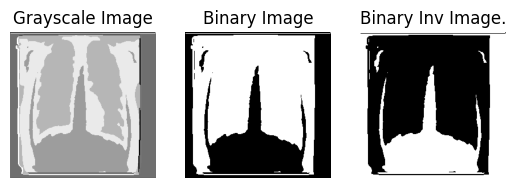

mask_manau_20925C23B55033701E8A6DAAFB1A452A5EFF8AF8A5B9080DB315F5C94E2F7781_20925C.png


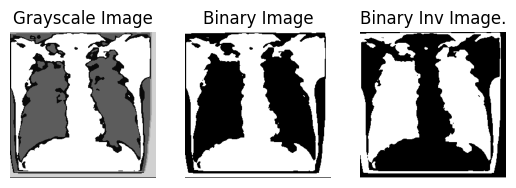

mask_manau_20CBE74DA41F02EFBBF989B1C38C1C2C73AEC779B59CABA1220FA38E2914EF08_20CBE7.png


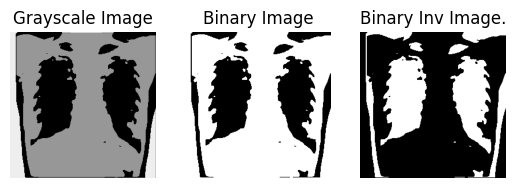

mask_manau_21B3D6E6F4C05FF5EAD2703C21B0CACC8A0BB026927A2599E6C94B61FD9BC13B_21B3D6.png


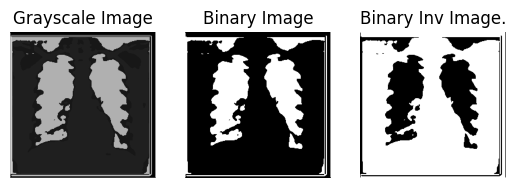

mask_manau_2222F33D343E3A88AAB1B54EF0A9ACCBF899A22B62561B01146FEA3FE83116F3_2222F3.png


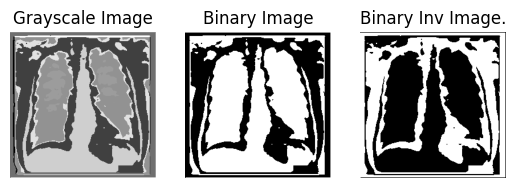

mask_manau_23F1D387F11B8699F01079ED982A07B448D25D32B469C024C5864FEBD1A1785B_23F1D3.png


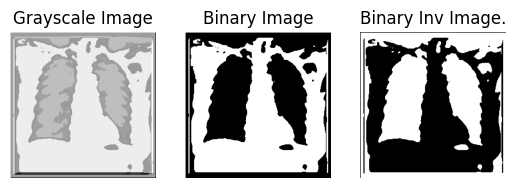

mask_manau_24F436EABF2D60F48CC21EBBA46CDF311C7B305BDE7D75DD3A039B2A121876BC_24F436.png


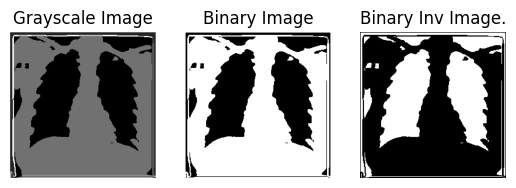

mask_manau_261BD312D7FFA1C2BE9484768E2D30D4D4BA442A8C219F948CD699A2422AFD39_261BD3.png


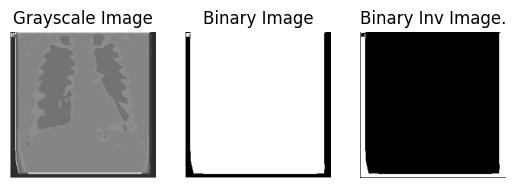

mask_manau_2641B8E7231586E47B83C787258B512DBD72B06226019BB6DF7AD7C1841B9444_2641B8.png


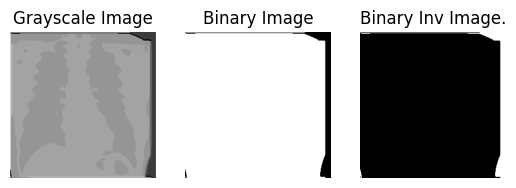

mask_manau_26D43D4664793132F0236D55E140F82B561710D2F4D3822D0FC8118283F921EF_26D43D.png


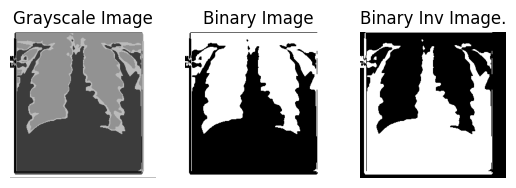

mask_manau_286333909D49CB0DC675B10127AEA82D09A50788460109D32BFA13DFD0EA2B95_286333.png


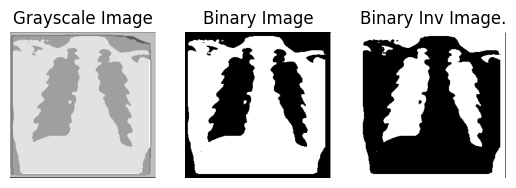

mask_manau_28BA76DD36925ECACAE79DDC92C5B52DA4AC012660166296E394C25E04315485_28BA76.png


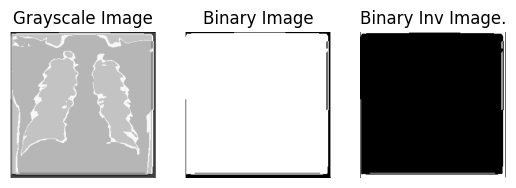

mask_manau_29932F1D24530535BB0C731A5DB0279388F88F4ED4354B627CB7543632394261_29932F.png


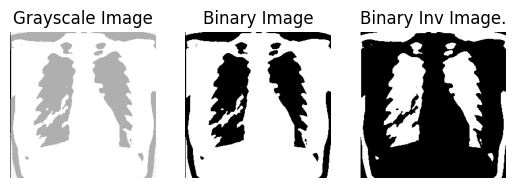

mask_manau_2A0F3F40A99593A9E9EFD6DCBC0651C669F4F58CF5FEA9FD385B50B6C841DE5A_2A0F3F.png


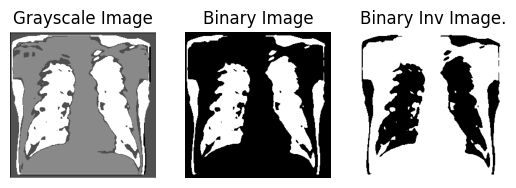

mask_manau_2A196B3F7F6E0DE378A89433E9C64967B9AE2429C1380443944F304562C8E97F_2A196B.png


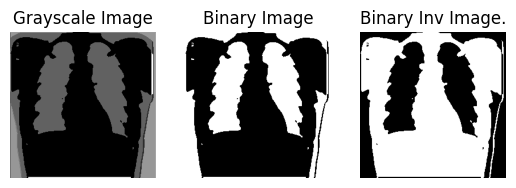

mask_manau_2D0E5811F07A6536FB262E4EE3CC983FB40453782783259933F0259D0DC13762_2D0E58.png


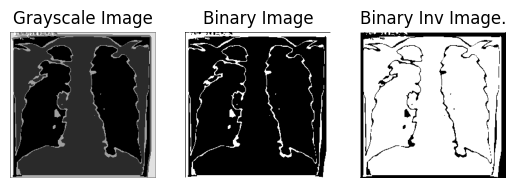

mask_manau_30518D46531DDF6268A95AC522EB56774DE3742A35B9A8C1921CDB86E1FB21C3_30518D.png


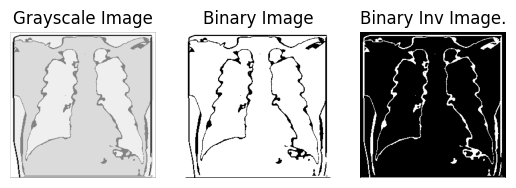

mask_manau_30D62280ED25B1ABF423FF7B202F9CA942D19B18B7404B8ABD2B2EE17C2DC86B_30D622.png


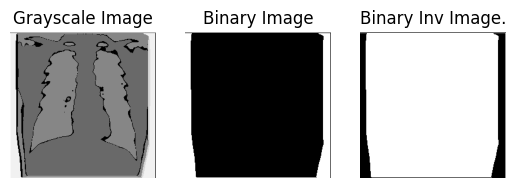

mask_manau_3506A2590FBD5181F996345CFC4428AA2DC056A24928B7637E99AA804782F929_3506A2.png


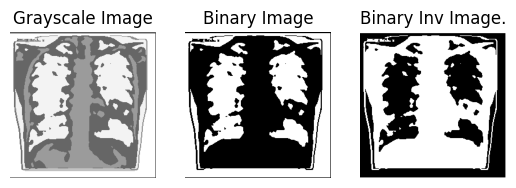

mask_manau_3612ED64AED627449E4AE3C223DF16D63BED82E3557D5BC171266A6B1DFAF69F_3612ED.png


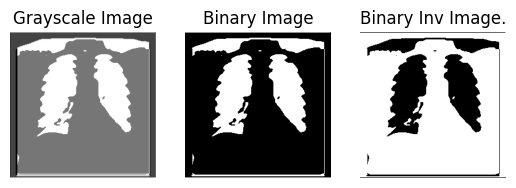

mask_manau_36776941F77A63AA734A4BC33B062EEB44FC5085CA7FE2CF8CDC5CF05CDD8FA0_367769.png


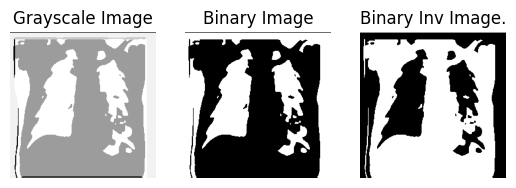

mask_manau_37322AB26B2DDE5929865A420FD30889CD99F979E060223D5AAA3BC4DD90A59E_37322A.png


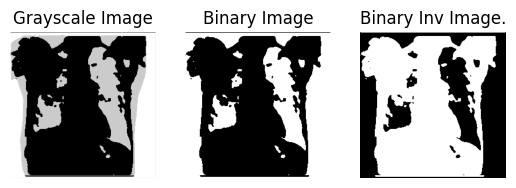

mask_manau_38BE63F4BECA0CBF19B1397DFCA4E5EFF4DFBACBA91932EC57C6410BA50B642A_38BE63.png


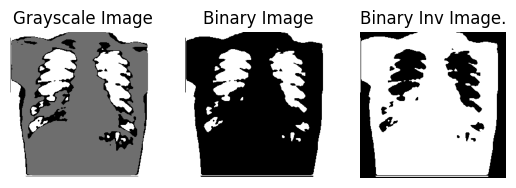

mask_manau_39FA31F2CDD478924F5A7F09E8961B5DF4CF932600A8AF5981DF8C7FE4EFAF4F_39FA31.png


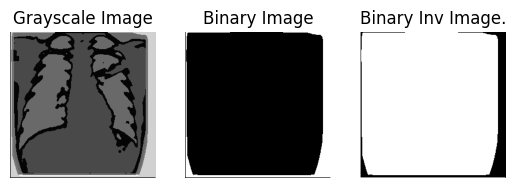

mask_manau_3E220EE0543D900513D963E6F4D000A23A5D89F06BD9594C7C6D32847CCC4A07_3E220E.png


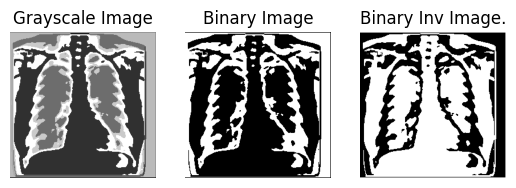

mask_manau_3ED287F897D882B4F04DB60645BDBAA884D387B67E718B1696DA52590B2B1BA3_3ED287.png


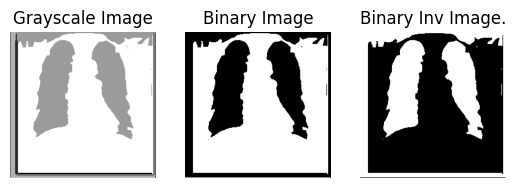

mask_manau_3EEFB83C9548E0A062FA41676987E6020D37DAD59926FB196CB38207A4957263_3EEFB8.png


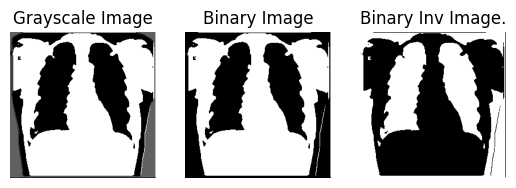

mask_manau_3F4B46DDF9DDB6EE7EC0CB81219F1420DEA0DF76044FE29189F98D55280B898B_3F4B46.png


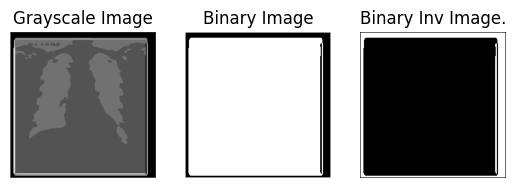

mask_manau_40DEEFF09C4CFA591A1582EAE54B0EF2BB96A9C8DBF6EBD5A0E9BCE4AFAB401A_40DEEF.png


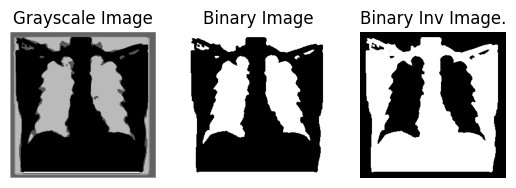

mask_manau_415579DB103DBDD16631DA9CDE32515160069CD01B9BFE8945470700FCF04BDD_415579.png


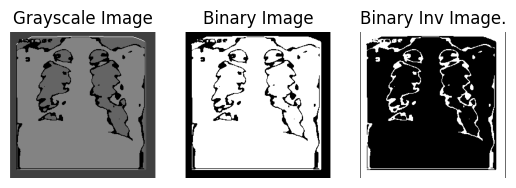

mask_manau_420FFD52A512EA66D5EF836874E3CDCFE12F0D03EC274687C3271BAE9BE424C7_420FFD.png


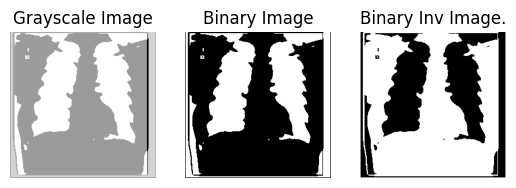

mask_manau_4238E8329C9A4F7A9C80A4C27A5855137837C15DB9EDA1F0D46011C04784CA71_4238E8.png


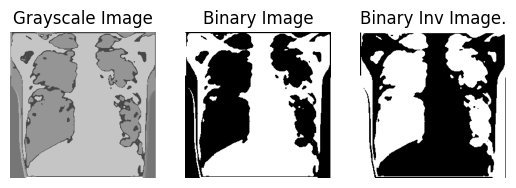

mask_manau_46D349B08F1829F7DD4B4174E5262321004AEF297163F90A38534FDB9AB2A06D_46D349.png


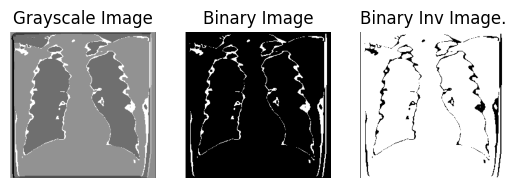

mask_manau_48AB8758EC6969FF64DE815AD8FB605E68775C076223C1108D605FB119C6F735_48AB87.png


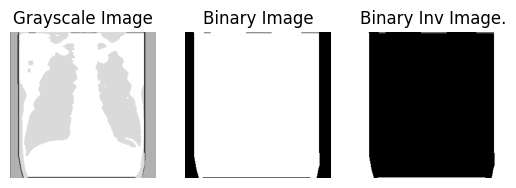

mask_manau_49A988356986215845BC340F80B92A6A7DBEDC8CD996AD2F3269BD40BC61B6E0_49A988.png


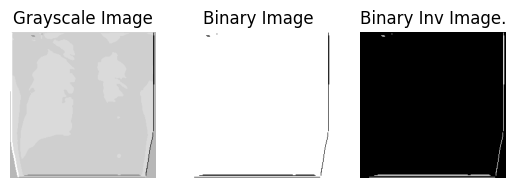

mask_manau_49D31303D87CE017E4F9E453D1E0D18E4D445F966D3321C100E1CA0793C17E3C_49D313.png


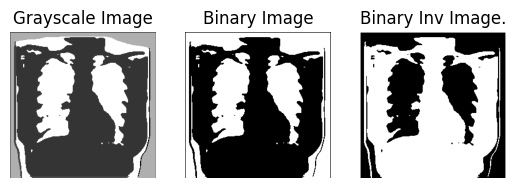

mask_manau_4ADEC6EDA6E8290DE3D4CF396377BDE3C7FE13544A0D5DB007E8B8B87FC2FBEB_4ADEC6.png


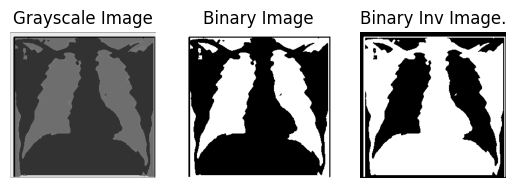

mask_manau_4B771BA7BBD954EBC9EDFB3BE2A715F5D3548AC0FA49DAE56ADDFDE02E2B4057_4B771B.png


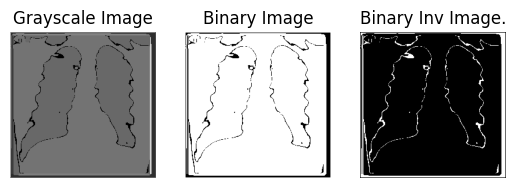

mask_manau_4CB8DAC1D720A4D2B7F75F94F191BF0DAB2C7DC7F9FCF3D5AAA6092B385ACBFE_4CB8DA.png


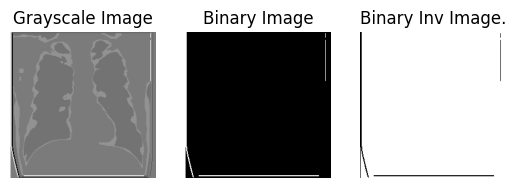

mask_manau_4DB2F9D564C029891468ADEA3C5BCFE2158D13FD2CBDFBDF7C68D3D8516E1B4D_4DB2F9.png


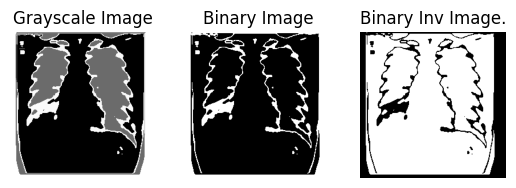

mask_manau_4F46479775B04AE2239E15841C1EC1911A281C381D96D9D41B96FE18609F7AF3_4F4647.png


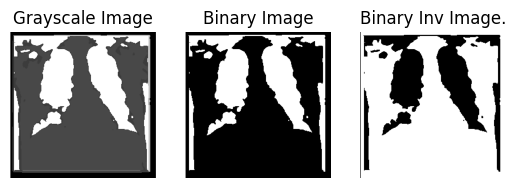

mask_manau_4F921D2C678E50B8BE5048DB90D80DDA9FE15E1A5D6C73F923EB8BF4B509980A_4F921D.png


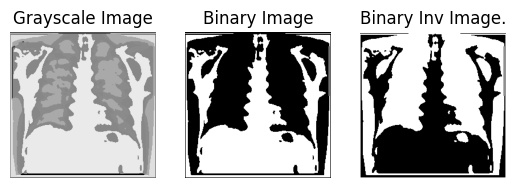

mask_manau_501F492BD8886344A2CBC82D87C03EDCDDCF5890CA339A84F415ED0521B3BD92_501F49.png


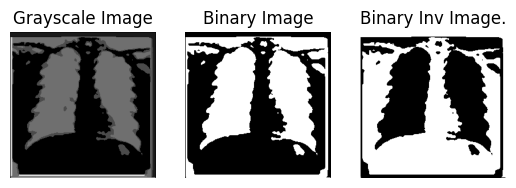

mask_manau_510D4340D29E9DA3AB383617FEEE70FB627A1BC554572D2BCEDA0598BD49A101_510D43.png


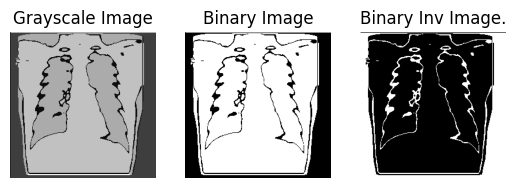

mask_manau_52BC50CFDC83F71AF0D7C0E7753EBDF4B1769433AF9A381840FD894D6902140E_52BC50.png


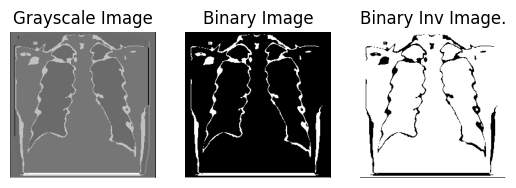

mask_manau_569E0A55968027AABDB5AC9E0B57C119E3AE01FBAF6CF0BE4E64C6A9425D97DD_569E0A.png


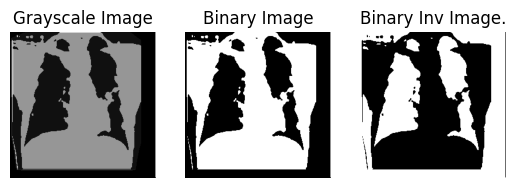

mask_manau_5891D57738DA5451842ECF26BC532A4D83B156263BF201AEBAF719A46A8C8160_5891D5.png


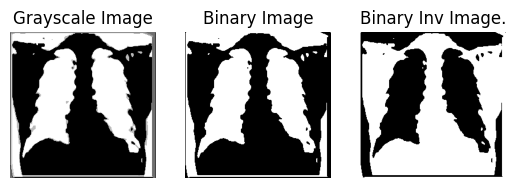

mask_manau_5A6CDAFAF82B594F5366BFAE5FEBDDAA4E78CC36B99C10DE0DBF2DF69EC74F20_5A6CDA.png


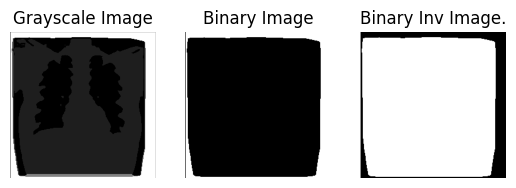

mask_manau_5A74CBC0FD6393B969EE9AB831E389A38592DA6FA9F97A665526E0463558FEB8_5A74CB.png


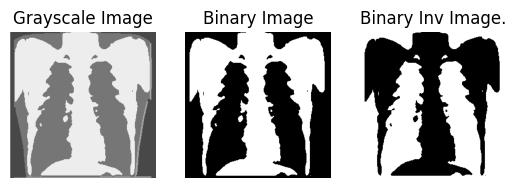

mask_manau_5C70BF4E7DA0D2111EF3056584994FCE7377682334A28B6773D75837404D2546_5C70BF.png


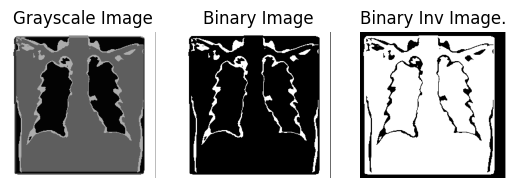

mask_manau_5C8CCA14BFC5DA95F375E291087BD8B388D4810D0E65328CD88CDF09312CDE78_5C8CCA.png


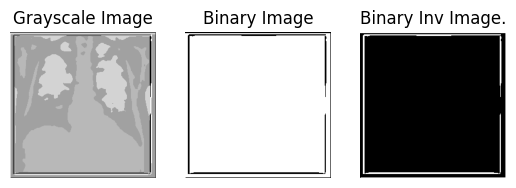

mask_manau_5CBABB126182C10A528CD9BCBD32724407957842E8FEC8CC3EA6CB7C503D0CE7_5CBABB.png


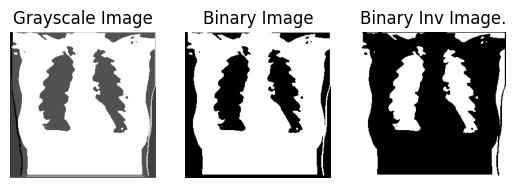

mask_manau_5CC548B964A1EDBEBD166CB08F05DEA1237AA93A5BD371D7CE68FCF7FEE2D488_5CC548.png


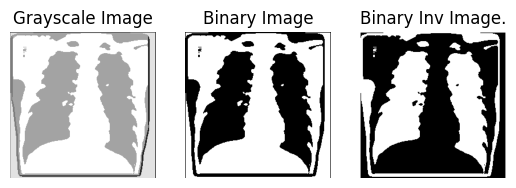

mask_manau_603506A101FD64FBDCCD4647D30C0571E1CF1551F79EA5F29BBF4013EF5CF99C_603506.png


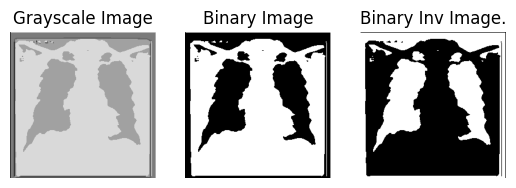

mask_manau_6121141FB93CEAA679A687882FF207F7352E5CB3DAE6FC3FFA5CA92527F43579_612114.png


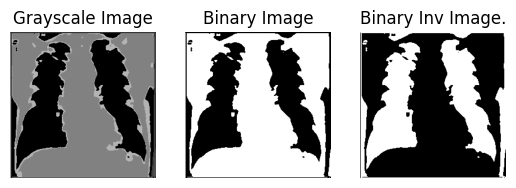

mask_manau_616E2DD784560312405D1B97FEE27B6EA1CC29E013B3E1AF48FAC47C6B2F2465_616E2D.png


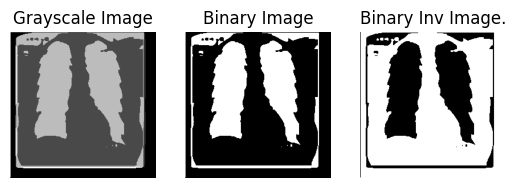

mask_manau_64531E5E0978B96F71F092AB198B50EC5EF4270B075E9D70136A5265D96EDFAE_64531E.png


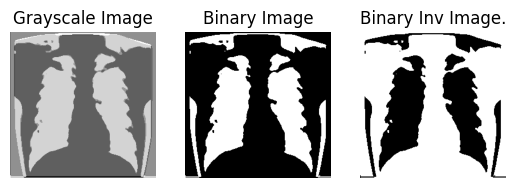

mask_manau_65F7B311FB02B0290F38F727F21D9B39DF5F32A0DC6AC636A4BB008A503D69E7_65F7B3.png


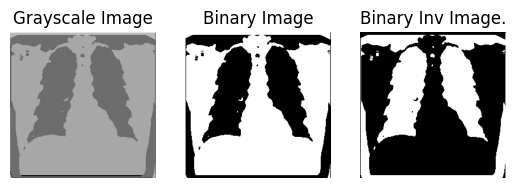

mask_manau_67136A051A54554DFC6A896E779505046F11B78CFDC9FC685EC2587F0F566EAC_67136A.png


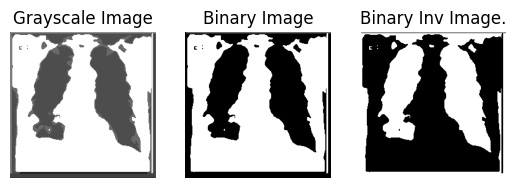

mask_manau_68770C75F206E66683759178198BD0E3E0701974E1CB04A634DF6112D625E6F3_68770C.png


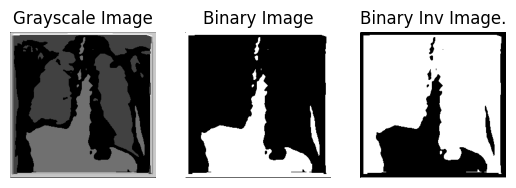

mask_manau_6AC62FDA97896E88F2C0DF45289EC8E3402045A6C1D05413B98B5DF62BC20B03_6AC62F.png


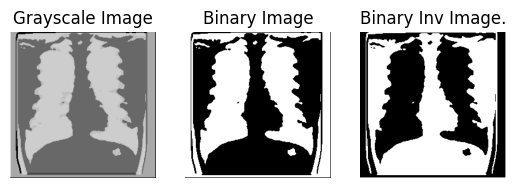

mask_manau_6B21299C28BFCCD95D8B6FDFE1A4CAFC18F286F580C1F0AA352592814AFB08EE_6B2129.png


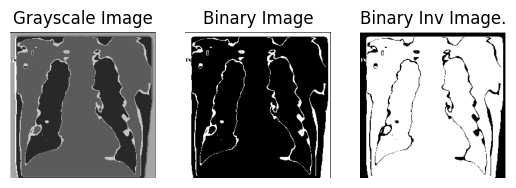

mask_manau_6C2D67F9521F078D36258677895011F171CB54E32F02751B6499D02A62EA84EF_6C2D67.png


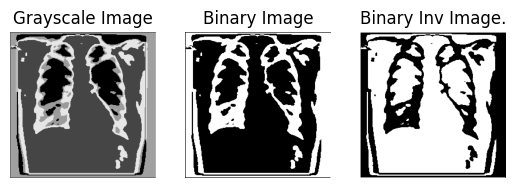

mask_manau_6D1D000EDCA0F9CEA42D7546528202C15F37FF4A155166CE26A0C992DECF4FE1_6D1D00.png


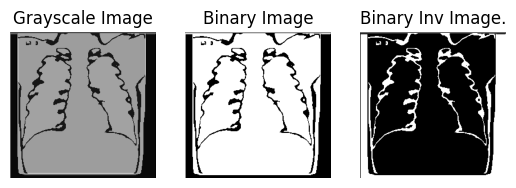

mask_manau_6DCF513C8A3163ED9A0917E99FD97904D89A37308A719BE6EC84DA0CFF4C3849_6DCF51.png


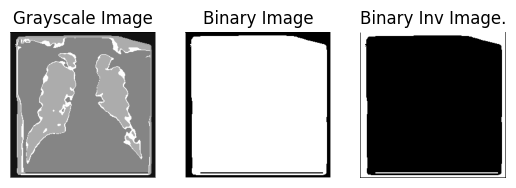

mask_manau_7073B29E166E08FD5D5FE544FF476EAFCAC88E96E0CDF9F35945538D0CA49FBD_7073B2.png


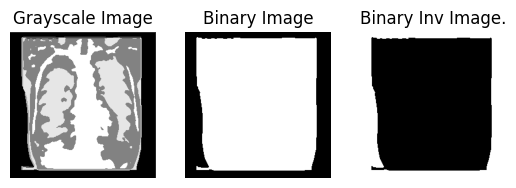

mask_manau_71D098011F99520C0ED27B297CAB0227C7E69D76F5FED84BFE5F985C35F52033_71D098.png


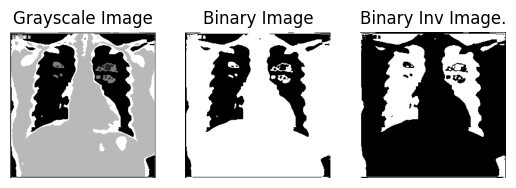

mask_manau_740E709A46823416D8D65E3371F120521644092FD6BB4D2D4BECB72EE70EE116_740E70.png


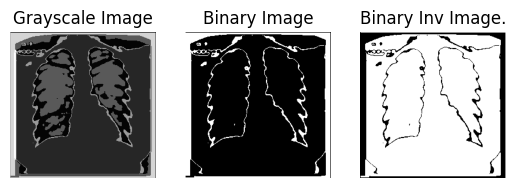

mask_manau_7572074C776E1138AE70F2BB69674A00DC347041A785297C46407A000EA4E587_757207.png


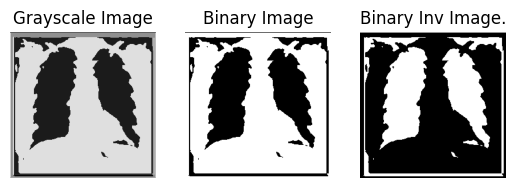

mask_manau_76429A4F27FEC6119ACABF02C2A10729F4F5C1C9DB91413900CCBC5E16BD1FA1_76429A.png


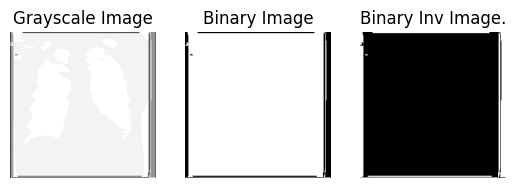

mask_manau_7680E73B62AAFBA8BC15E8FB56610807C8A52ECE4FE0443A731C744AC6E1E645_7680E7.png


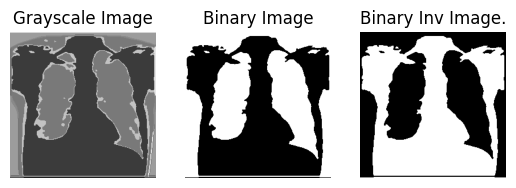

mask_manau_7D8861D5CB2A9E99F5F6CE05C1D5FE1752D0F5EF59BB1503B2ECF625DF39C4F4_7D8861.png


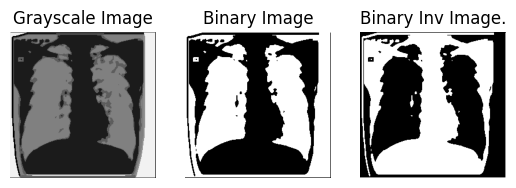

mask_manau_7DFEFDCFDCC64D4DD8DE6C30939E5862749791D9A5BCC9753EBC1A833D1148B3_7DFEFD.png


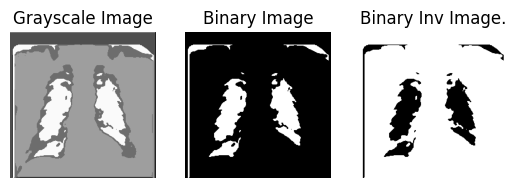

mask_manau_819D3D66D7CD3B04C8ADA8D64D96B542AE8AE05BEDE8E567606D075BC757A6B1_819D3D.png


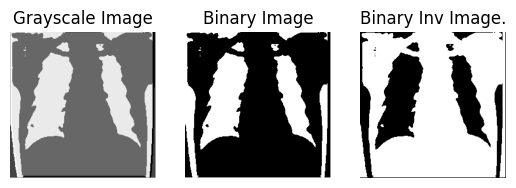

mask_manau_843F15761C4A431314EA59A546AD99EF081C623B315AE35A93A462677949F3D1_843F15.png


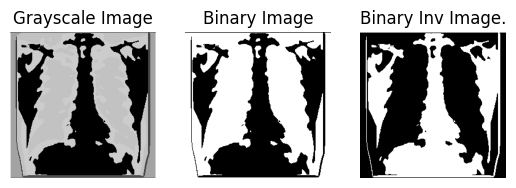

mask_manau_869E3A06E1364C1A1044BCB51CE6F85CDE0736633A4852446F451B08FD4CC234_869E3A.png


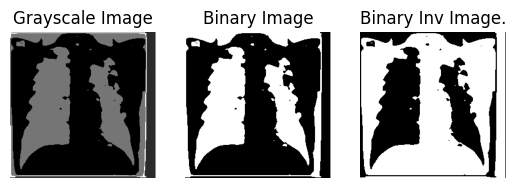

mask_manau_898E7C1953ED0F0E294D1F01F994236F6AC3A6654159B05FE1EF0FEC605B36F7_898E7C.png


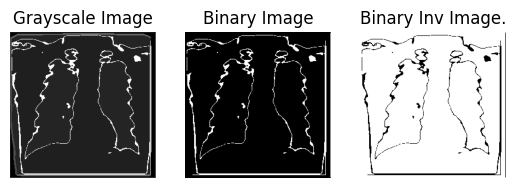

mask_manau_8A737BB42D78DF877133BC5D4435A23FD3F1A0C32891A073F9501FD3FC1B17C5_8A737B.png


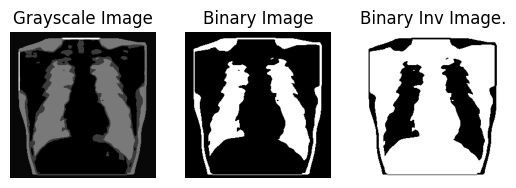

mask_manau_8BD7353C9EC33F12645A4A099F51CB9FEFDC25BB58E3E8F421D2ACD46D17EA5B_8BD735.png


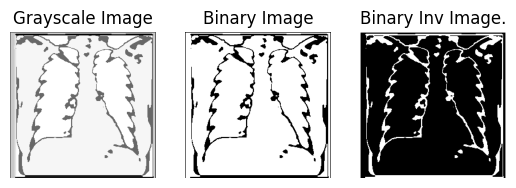

mask_manau_8EA2BAD9A28D2F3273EFE6035A32470B8EB72FDA8D0358AF3ADF0E732637F59B_8EA2BA.png


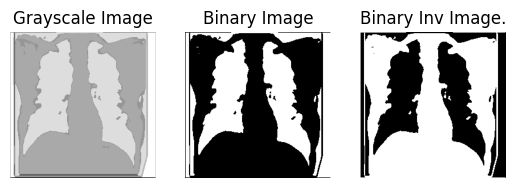

mask_manau_90E6F6A8A6AD35656754393A501BE151A3D429263D3C2E28094A738834749157_90E6F6.png


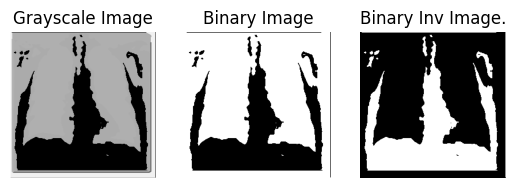

mask_manau_91FFA3D79D8416D680C60AAD48CA5FD9BCA70549053CABA46330A0B9D55FEA27_91FFA3.png


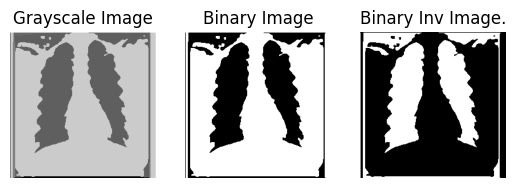

mask_manau_92787C62A71D03133B258D14C47899FD2F8DD5AB06A3D7DC09E8AA8C5DE8AEEE_92787C.png


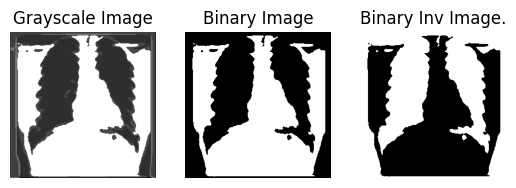

mask_manau_9353B8B18766716E15F80062249B76DACF09273FA8C30499504C06EC331682B2_9353B8.png


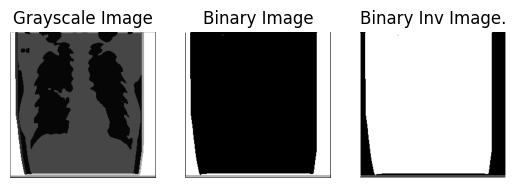

mask_manau_9B18E3607DB2D0FEAE08DB24670782E75DAF52BD1C379D33A686B9D22E1626B2_9B18E3.png


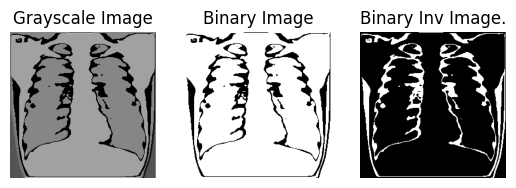

mask_manau_9DC82C85F36C2CA72F9729B347934676DCD1E1C6E67065AA57765807418A7616_9DC82C.png


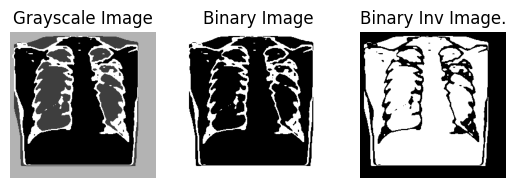

mask_manau_9E726B6435B1B622752C9AE51FCAC100140680FFE24F8953C1A2520304FDC4E2_9E726B.png


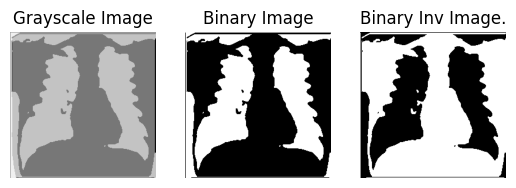

mask_manau_A01062AE6A60DDD7AF53C1F333B97D12B4AB1E0D425462C898AACE826CEF887E_A01062.png


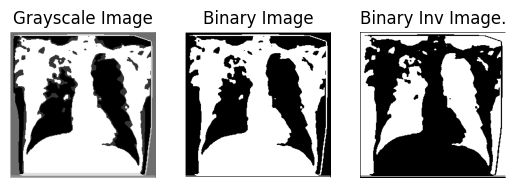

mask_manau_A010C45620648B718C13ECF6C45090C57FA107D0839E85D31E51A5E61EF67F72_A010C4.png


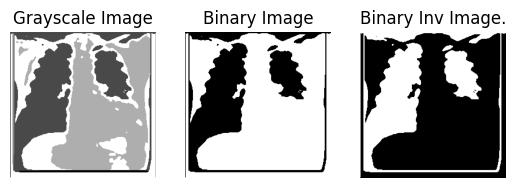

mask_manau_A11F102786E9256772306E166871DC3F412A999F47BC9C38172518C175678143_A11F10.png


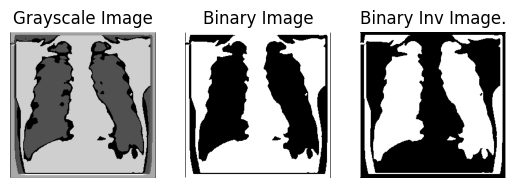

mask_manau_A2038CBE808AF1A921E1A4F1ACE1A60A64AE210637F8D77CD1A9327FD16DF972_A2038C.png


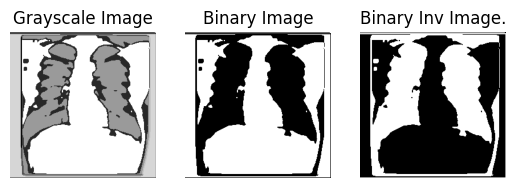

mask_manau_A385262FDBF521145D26195B7F984ACF48E5F69635B5E2D5568CBD4F7545386D_A38526.png


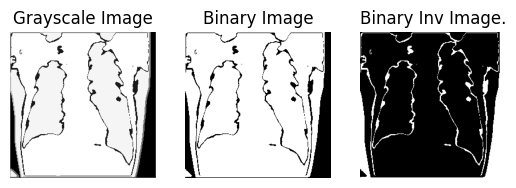

mask_manau_A4D45EDD66D4D1FD5B7E370FFFD3F1E36A886D0534787FDE1CB965E12A855A9B_A4D45E.png


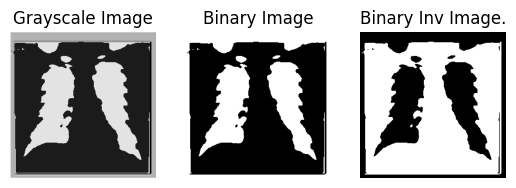

mask_manau_A585B03703B60EA31E09E4581055C8FF72FED5C4E8A528C8FF4E8469F4C4C0AE_A585B0.png


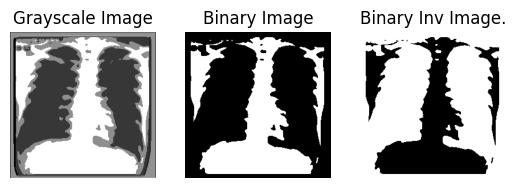

mask_manau_A600649C2E93E90C9BE5337CD1E5354B0E44BF42C0CE9611BFA9B0F59A248909_A60064.png


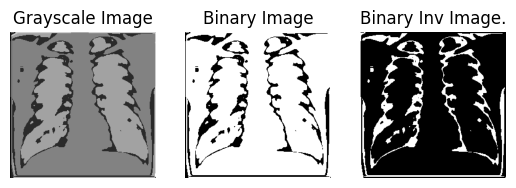

mask_manau_A6BDDE07D1E4EC082EF366E817C746A392F66848C9A92A4CF74CC97784B406D0_A6BDDE.png


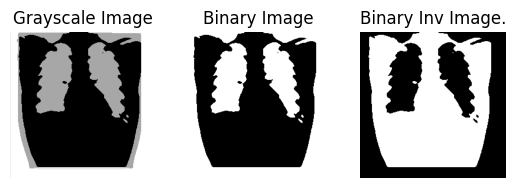

mask_manau_A94B56551B1AAABE5F7C145FD84C03D436EDA5F65081C751DE034401B9D67A02_A94B56.png


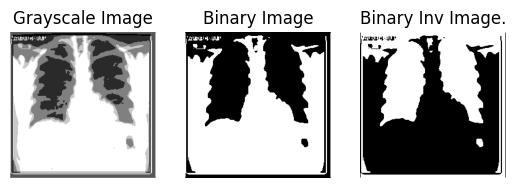

mask_manau_AA4D1D6A97CDCCF351E2FFED56646E5DB120355A47C9B0A1370919CF10E8CF56_AA4D1D.png


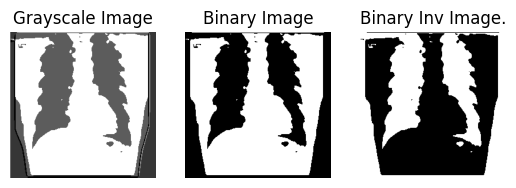

mask_manau_AAB9BF929A26DC980F2B4502E35D428553360471C09BA7B3D9B98F89A6B6651F_AAB9BF.png


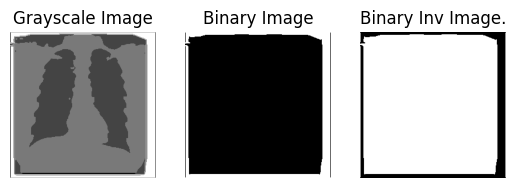

mask_manau_ABA781E747497C0CD8A25F870B773D6EA5011414C21305BA074E011B0FA4E6BF_ABA781.png


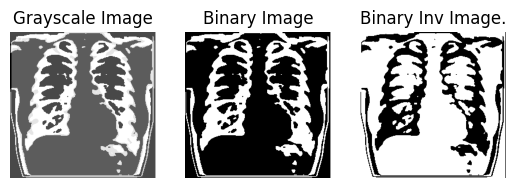

mask_manau_ADDF08133A572A0A359F9498CD0C46DBB68D05E34EA7C1953698ED6286ECDA47_ADDF08.png


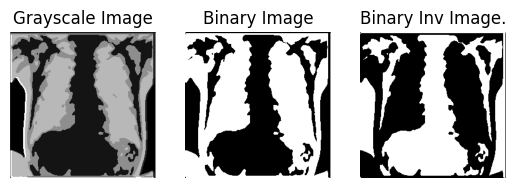

mask_manau_AF2FF3989908BBBBEDF33A3E2B0848483AFC21097065A2C2EE2D1CE5B9409D80_AF2FF3.png


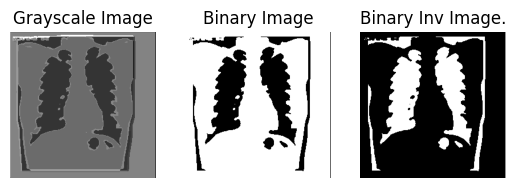

mask_manau_B25F0B4D77BA5D79C66787D7BEA85BB6F6AF82DB7AE20DF0EAA0CA4A959C32A7_B25F0B.png


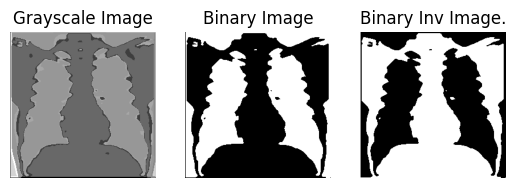

mask_manau_B2694C694358A12E1C6BFFC441CA886966471FAAEFECF69A9051C25714ECE957_B2694C.png


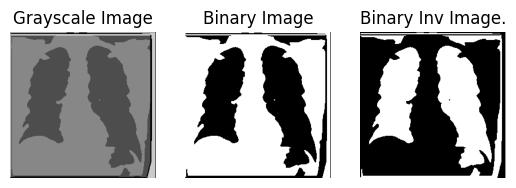

mask_manau_B50D17DC09533C98E76D2078EDC5914345CEFA47A4292B4D399D0EDEF110BD2B_B50D17.png


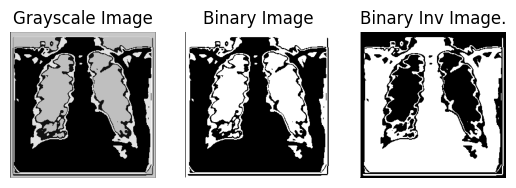

mask_manau_B5C43A59F2A506089E4532211A506C88757EFCCE8E3F066239EAC7978F6A2C56_B5C43A.png


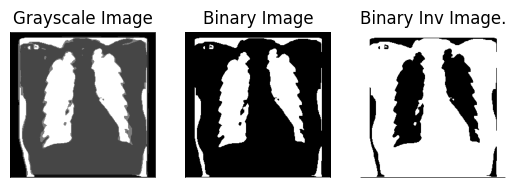

mask_manau_B8FA1AAB04CE2826B1207A8FB6F43894ABA4606E4297B0552149BD6A323CE259_B8FA1A.png


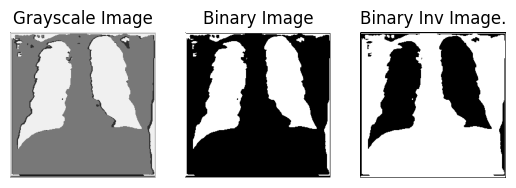

mask_manau_BA519C932E61061306715914AAE7AF3FD748372291862353B5CC0B785F784FCF_BA519C.png


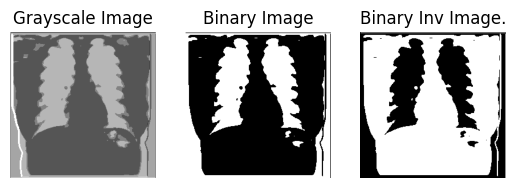

mask_manau_BAC72A546FE48860370C5AE8A73BD3AC5C0D3DF8645CF408603ECB5EF775371F_BAC72A.png


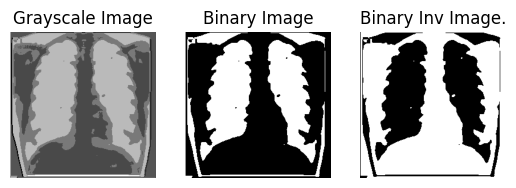

mask_manau_BB7344FF1A53D87CCFE82F0053D42DDF392CA25C585E8FCB8AC61C4B0AAFF518_BB7344.png


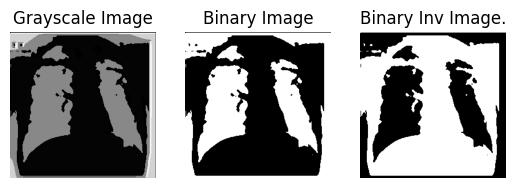

mask_manau_C1F19AD55EDF1FF7B6257930C7793C6D7CC12D06334BDC5D3A7E4EDEF3120B65_C1F19A.png


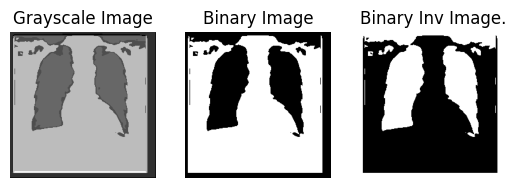

mask_manau_C3F321E1563BAA184AC67DA15087490CC045CB38E7C16E0F8FFB28259B21A2B0_C3F321.png


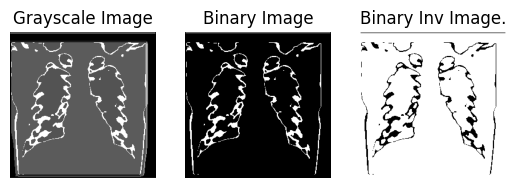

mask_manau_C4630F94243177A9FFA9D6867936971E9928F60BFCC96005DB40F8B32FA0EFC6_C4630F.png


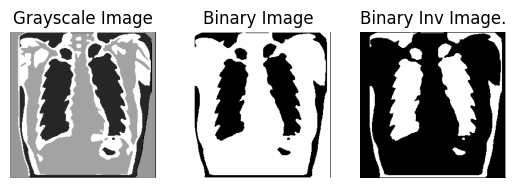

mask_manau_C5413393DEED24E62B4FC26C7889EF77DF9BCACA081A844039E6B83F9E3BD140_C54133.png


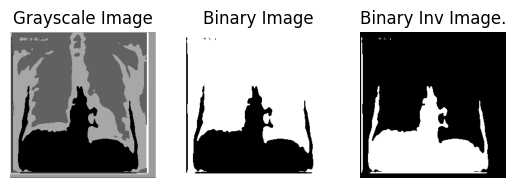

mask_manau_C5EBADC9827F738C1856E522711C9C46A6CBD22002AB10FF04CDA3BEB757468B_C5EBAD.png


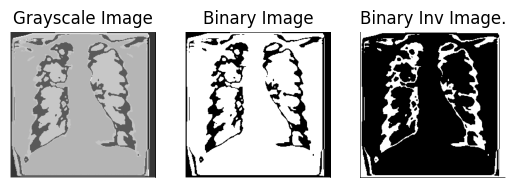

mask_manau_C6343037A33757BB86097EF50525085F0424B1DB508DC658FA2168E9BA78D3AD_C63430.png


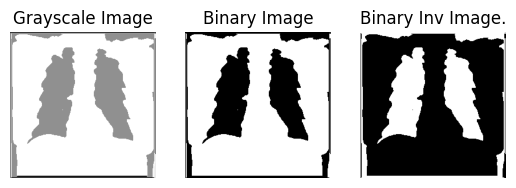

mask_manau_C6E72A83BEC7A07A50125D22A0EF5B095928C58B08C81C7F702D7878A631356E_C6E72A.png


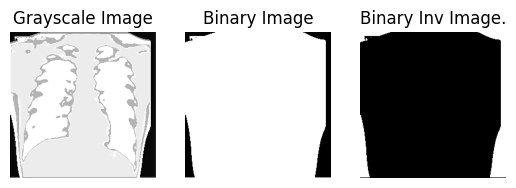

mask_manau_C762DD3BB89C0873032FC2A632199A842F9799D179EC724E6F22580B393517AD_C762DD.png


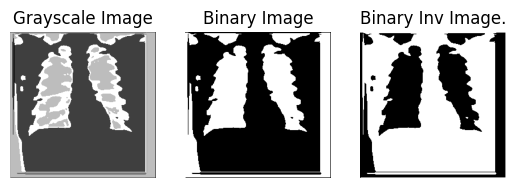

mask_manau_C80FA0C21E9992B03FBAA605350F3A1425F37CA3469C05FCD151B778C9016E66_C80FA0.png


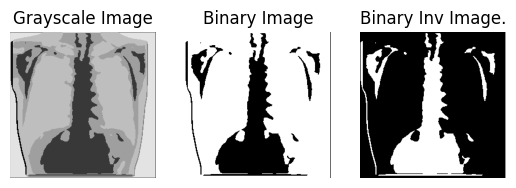

mask_manau_C830A67F2122FB763D563E88F948FAF9240F21BC222A025D8ADAAF2C30DE82AC_C830A6.png


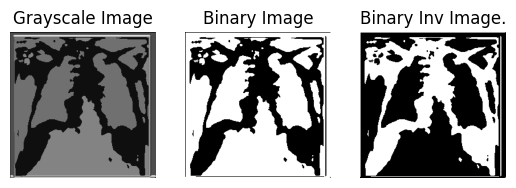

mask_manau_CB94947A7D8406766B22743A73AFFBE74C9B191DEBA7A4C8AD6ADFD19D30374E_CB9494.png


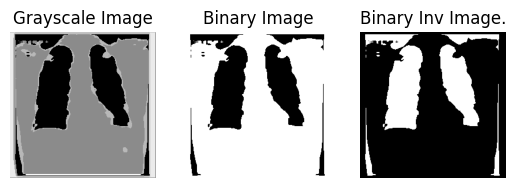

mask_manau_CCB1D32975C85049D26DB40717073E0847FB6DE16AA9BB293F747541A11660C6_CCB1D3.png


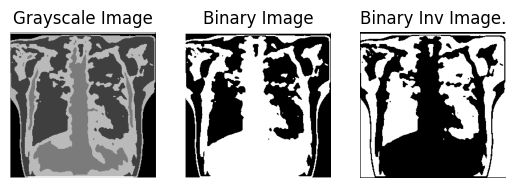

mask_manau_CCDC17C5616CEAF03951F6715B7C9FA01E01518ED04E1A84552839EAC0FCA413_CCDC17.png


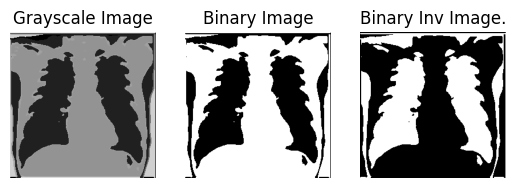

mask_manau_CD8D93AB33C44E349BBBA9627454C820B8320241BDA23416C0CCB5D3F8408ED8_CD8D93.png


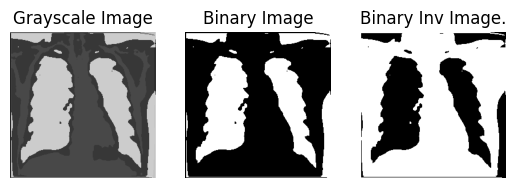

mask_manau_CE8BD5C1F79665B5A9156829A7B7042EEC0F5E4FB28AD336CE74C077DA167BAF_CE8BD5.png


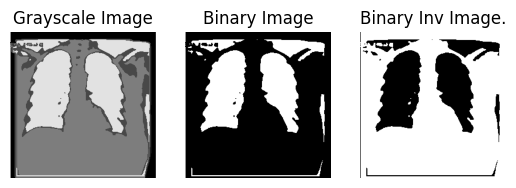

mask_manau_CEBAC9831396645A2FD5550BFC4DE082118202E0B1423E55BFB2BD5B419C2701_CEBAC9.png


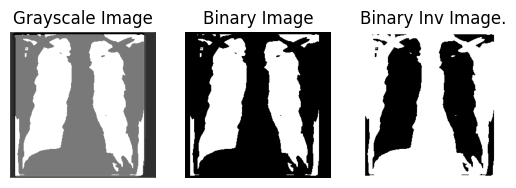

mask_manau_CF0D13C14D123E0C67FDFD0DB591D2F2EC1516F59E7A9B91B1DB9A2E9C5D91B4_CF0D13.png


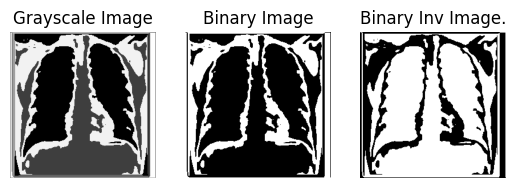

mask_manau_CFE7AF9897B2165C01174EF508ACA31DD54E61BC62256FF799DDEC4ADDF54A4A_CFE7AF.png


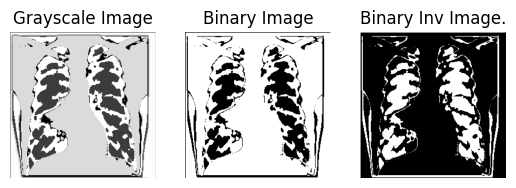

mask_manau_D033A03BD6F759422252C52D127255B7621DBB21B9C9794049A2CA2B3D073824_D033A0.png


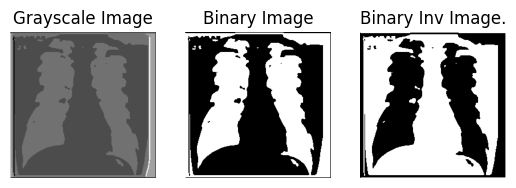

mask_manau_D2D46D209B8562BE30FE175D0FC4F9AC4ADC5C1D2BA5B7E82D3C78AB3A3A894E_D2D46D.png


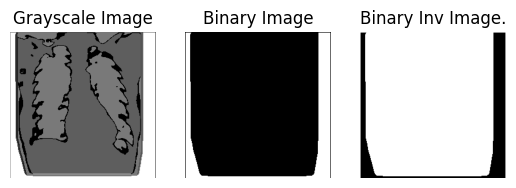

mask_manau_D444FB81E18C6BAE1573CB780C6018762C5E759943816F520FCAB4EF1DE6FE05_D444FB.png


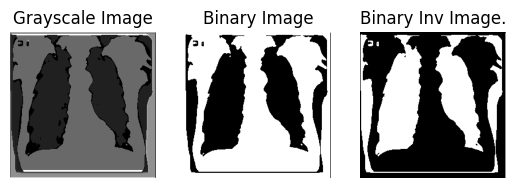

mask_manau_D51148D63A7A32177B3015EDE5C2F82F599E6DB7751F846D52E90D265F5BC1DA_D51148.png


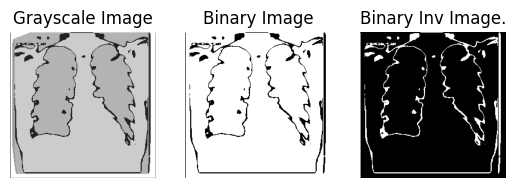

mask_manau_D57CE683FB92865BFC0730F39EE50990217F94AF44D720DFAA1D4EF6348AEB70_D57CE6.png


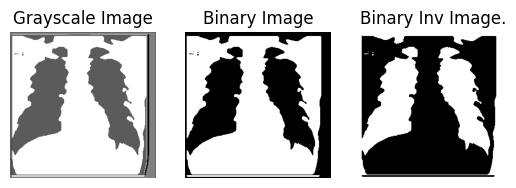

mask_manau_D6DB3338321265F7EAB3C58E071FB020D9BB1368E2D43DD9428D978372D3CCF0_D6DB33.png


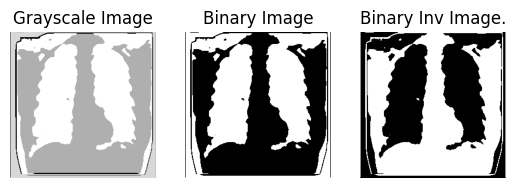

mask_manau_D74FF1B9A4FDE4FADA8D361F012F96725D3AFADCBD6B473117D4D4BD1F83CC4C_D74FF1.png


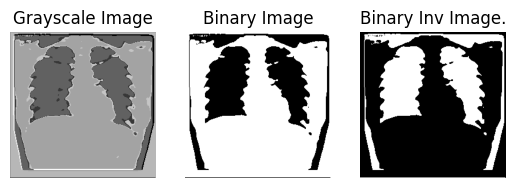

mask_manau_D79019192A7230465FCC442E1B351C0109302E10CA8E37855BF16B46E836439E_D79019.png


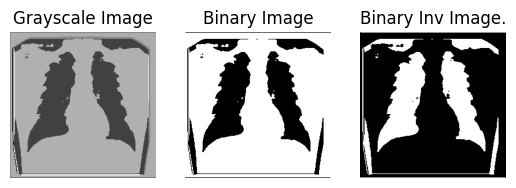

mask_manau_D7AD3E351E566A49ABBC35A11187D8C496C158CB20365CE6EF389AEF576B6B1F_D7AD3E.png


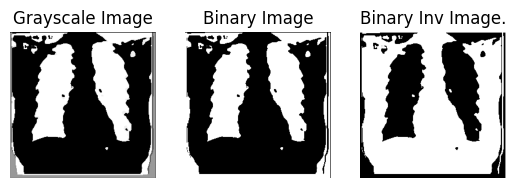

mask_manau_D7F88D284D73A26C47A13C23C3C4AFB36EF359B44DA7075AE909D1B2BB46655F_D7F88D.png


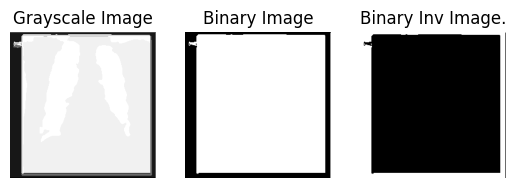

mask_manau_D9A60877C17483307E32F8F35E236F2BFE31A79D54F751D10402C13455951139_D9A608.png


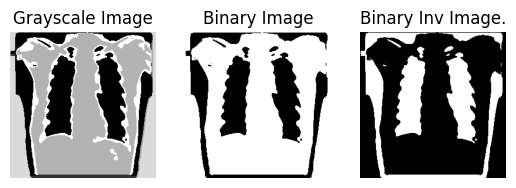

mask_manau_DA297CD0DBB4A8C595E139C6DCDEDF4230AC2148AD74C18A917D76F37FBCD7D6_DA297C.png


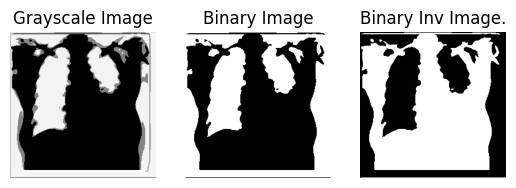

mask_manau_DC951BDBD1EA7717E455FC4843CF5E78425823399EFB794EA6635D75806E4146_DC951B.png


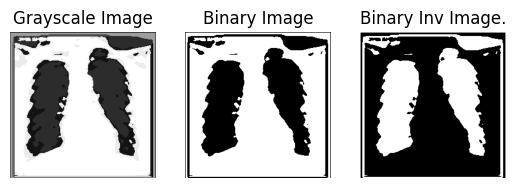

mask_manau_DD9B73F7C68126F634BE95CE64E1E1EA6C0BD3D9FC1436D4E8E17400648393E4_DD9B73.png


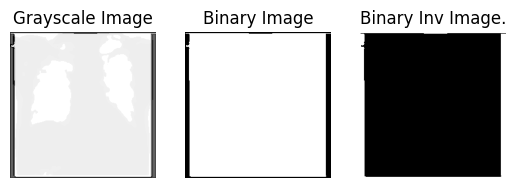

mask_manau_E24E1365E705ADCDDF2B8BF185C61805FD71EDA9A50D93B099D41E6940EB6EB9_E24E13.png


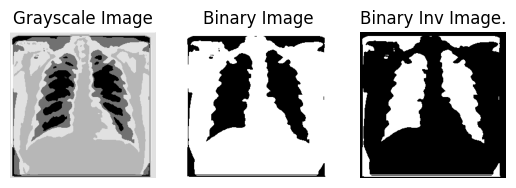

mask_manau_E4865B25B888BE1062F238739749313A94B6B5BFEF411D1B0A96C20A32438EA8_E4865B.png


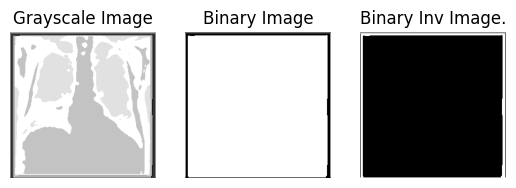

mask_manau_E4E63E4D3702FA742F3F88097698AE7B62AB623495739808DA48D44025E4BDB5_E4E63E.png


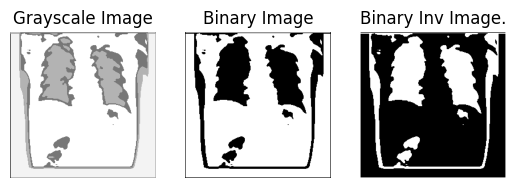

mask_manau_E90FAFC531C24B2D37189A2CD9FD89199BA099FF74A9DB0A1E944A99D940EFE5_E90FAF.png


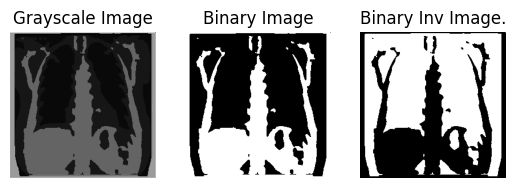

mask_manau_E9F79AA07111855C511936412714771FC19290B3BE583C7978051C73394C93B6_E9F79A.png


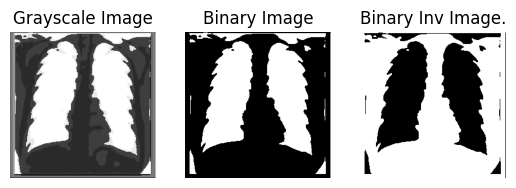

mask_manau_EA042E41C10DD05EAE429CB81416AB88C912EAEC22E37DF0CD096F4D135B177D_EA042E.png


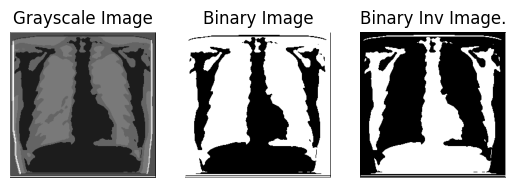

mask_manau_EA487885D7A4D13A9636D2172BA4398C36D98CCC69B17B4C414A69E09FBC3AF0_EA4878.png


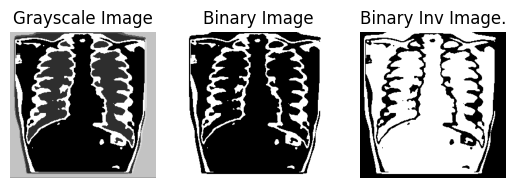

mask_manau_EB9BB5C049BD5BBEA24A6C8A5AA9CE584035AF7ED1C59AC32502EEA4A028FF13_EB9BB5.png


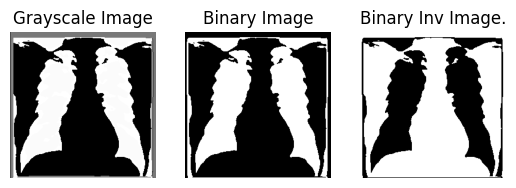

mask_manau_EBE6802FE68FE284710195A0E9DB5D7BBC118F86CDAFE4F8822CB3CF5D5DEFD3_EBE680.png


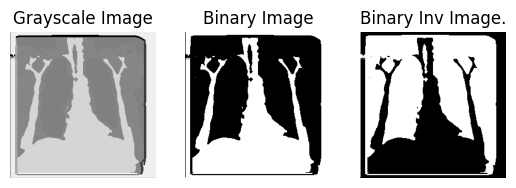

mask_manau_ECE8D57501B257CAA400FDE84A1E51AF844C387970846ED9153FD4C46D8B1A47_ECE8D5.png


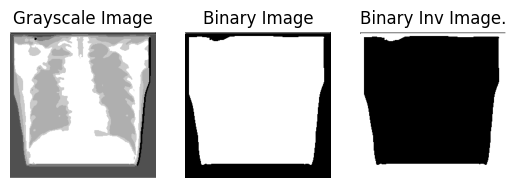

mask_manau_EDC6D9BFE473926F8E20D8A401F7BF82602A3D20BBA3C4300AC69DB9B8D42249_EDC6D9.png


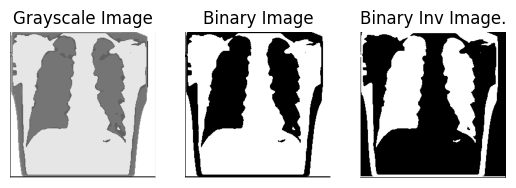

mask_manau_EE950B67D66030BC566152EC57E484A0D70A9B4A92F1FE863D37D1CD5D294559_EE950B.png


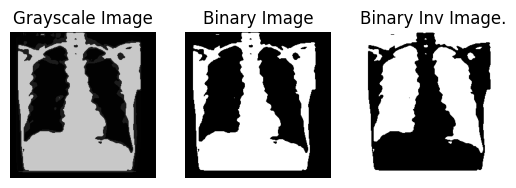

mask_manau_EF05647CDBCB4BB94013946644A5802BE35BFD2E4CB64554474C9CA54BF93331_EF0564.png


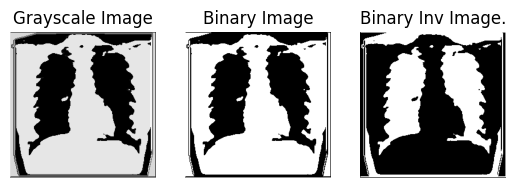

mask_manau_F08A70F72373E2B207B3DBD77A463EFEF30397F1A7C25862565B65ACEEE16470_F08A70.png


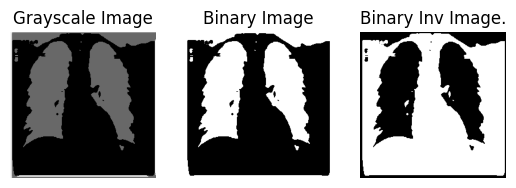

mask_manau_F1D9A54040F13E65A1A599A3A324E5734CD4D15FE1937734CD94F2FAA1C61EF6_F1D9A5.png


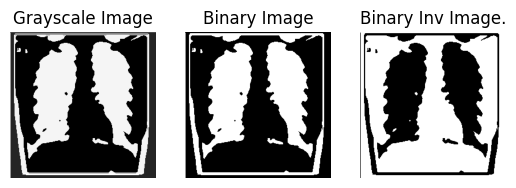

mask_manau_F206801C4E8FC3891C7BC3A5737804AFC20FF5EED6D4A58F7D49AA0D20DA5376_F20680.png


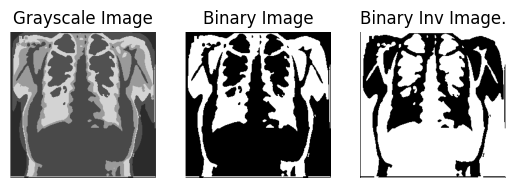

mask_manau_F47E1F0612325AB1D3A56D28777CA5259C553F4575BE6CA13A5F66990C0FB0E0_F47E1F.png


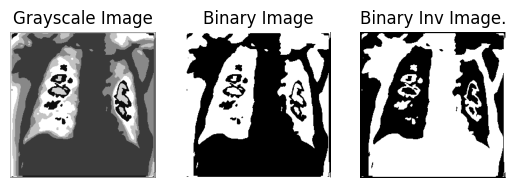

mask_manau_F4A62B3237E10B88F9FCF68A05CB07FDC1E11CB20B2054009D3D333F0014BF8C_F4A62B.png


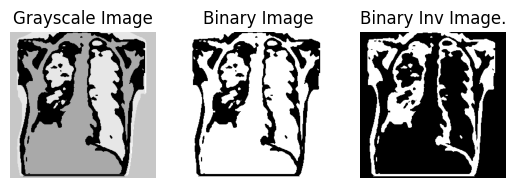

mask_manau_F8C5F104E94AC249D48AA4D35E06C8A29E4764EFF50E7864EB3693C4FB122AC4_F8C5F1.png


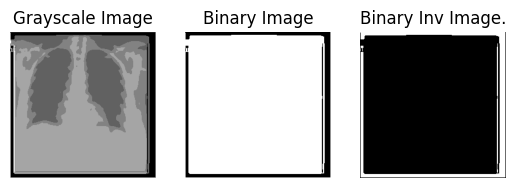

mask_manau_FA7E85B7206D61426BE5909488CED27761D68CE9CB5C2436E2172A0BFA92DF17_FA7E85.png


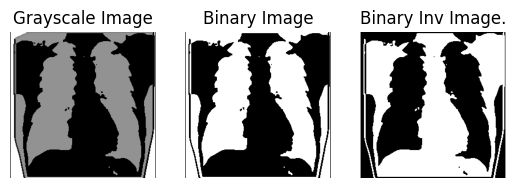

mask_manau_FBE5CE51D7B0F046C5816A437910BBB39FB9FD07DEC0AA6D348239D185E97A2A_FBE5CE.png


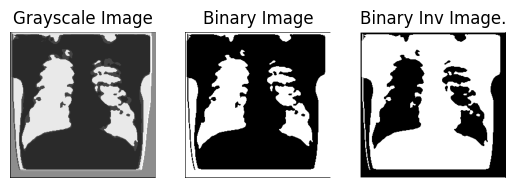

mask_manau_FC4EC4C14E09320BB3E1207DA3666B4B74791A2E20F3EFDBD72DD9FE8728D401_FC4EC4.png


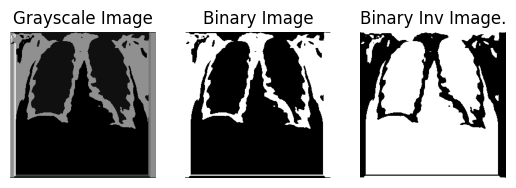

mask_manau_FD76E1E8EC3C283919E0FFF954049F91F30F30CB17A7ECB867C9A5B0EBCDDA71_FD76E1.png


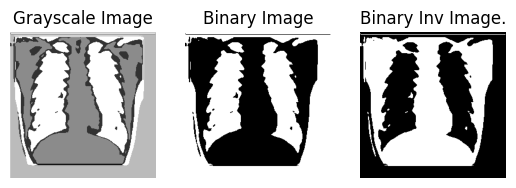

mask_manau_FE0742AF3063CED1BB853EA393F6B7FF6F8ABD70B9D5A041A742C9D5829AB02D_FE0742.png


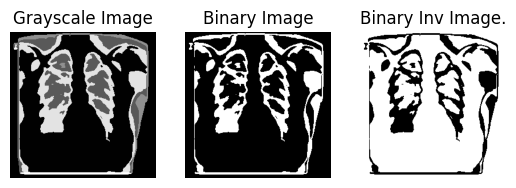

mask_manau_FF3C2B446516E2BD4B979D74A1860ADB03B9E8E4A7A43FB556686CEEC16A2E55_FF3C2B.png


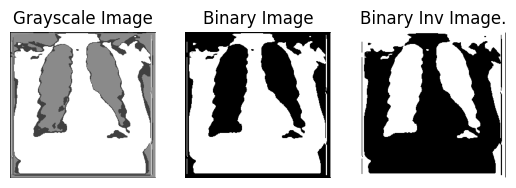

In [30]:
path = '/home/otto.tavares/public/segmentation_wnet/results_masks/Manaus/'
imgs = np.sort(os.listdir(path))
l_thresh = []
l_thresh_ = []
for im_nm in imgs:
    im_path = '/home/otto.tavares/public/segmentation_wnet/results_masks/Manaus/%s' % (im_nm)
    # load the input image
    img = cv2.imread(im_path)

    # convert the input image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # apply thresholding to convert grayscale to binary image - adaptative by otsu
    ret,thresh = cv2.threshold(gray,122,255,cv2.THRESH_BINARY + 
                                            cv2.THRESH_OTSU)
    # apply thresholding to convert grayscale to binary image - adaptative by otsu
    ret_inv,thresh_inv = cv2.threshold(gray,122,255,cv2.THRESH_BINARY_INV + 
                                            cv2.THRESH_OTSU)
    
    l_thresh.append(thresh)
    l_thresh_.append(thresh_inv)

    # convert BGR to RGB to display using matplotlib
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # display Original, Grayscale and Binary Images
    #plt.subplot(131),plt.imshow(imgRGB,cmap = 'gray'),plt.title('Original Image'), plt.axis('off')
    print(im_nm)
    plt.subplot(131),plt.imshow(gray,cmap = 'gray'),plt.title('Grayscale Image'),plt.axis('off')
    plt.subplot(132),plt.imshow(thresh,cmap = 'gray'),plt.title('Binary Image'),plt.axis('off')
    plt.subplot(133),plt.imshow(thresh_inv,cmap = 'gray'),plt.title('Binary Inv Image.'),plt.axis('off')
    plt.show()

In [10]:
len(l_thresh)

167

In [70]:
#getting a center retangle of the image, so as to binaryze by lung information
height, width = gray.shape
upper_left = (width // 4, height // 4)
bottom_right = (width * 3 // 4, height * 3 // 4)
rect_img = gray[upper_left[1]: bottom_right[1] + 1, upper_left[0]: bottom_right[0] + 1]



array([  0, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255,   0,   0,   0,
         0,   0,   0,   0,   0, 255, 255,   0,   0,   0,   0,   0,   0,
         0, 255, 255, 255, 255, 255, 255, 255, 255,   0,   0,   0,   0,
         0,   0,   0,   0,   0, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255,   0,   0,   0, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 25

In [4]:
(1 - 11/167)

0.9341317365269461

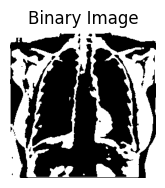

In [44]:
plt.subplot(133),plt.imshow(l_thresh[1],cmap = 'gray'),plt.title('Binary Image'),plt.axis('off')
plt.show()